## Marjanovic, Hofree, Chan et al Cancer Cell 2020 Analysis using SCANPY
5/14/2023 - Data generated from Cancer Cell 2020 paper, transformed into an anndata object by Jonathan Rub
Analyze global run and create h5_ad files for further analysis

2/24/24 Analyze for signatures of cancer cell clusters - no regression

8/25/25 Rerun with updated libraries for coherence

Note, install a conda environment with cellrank, palantir, and moscot

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc

import math
import matplotlib as plt
import anndata
from pathlib import Path

In [2]:
plt.rcParams['svg.fonttype'] = 'none'
plt.rcParams["font.family"] = "Arial"
#plt.rcParams['figure.figsize'] = (3,4)

In [3]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')

In [4]:
#Path("./figures").mkdir(parents=True, exist_ok=True) # generate figures here
Path("./write").mkdir(parents=True, exist_ok=True) # write h5ad here

In [5]:
results_file = './write/Marjanovic_et_al_LUAD_data.h5ad'  # the file that will store the analysis results

In [6]:
adata = sc.read_h5ad('GSE277777_luadAdata.h5ad')           

In [7]:
adata.var_names_make_unique()  # this is unnecessary if using `var_names='gene_ids'` in `sc.read_10x_mtx`

In [8]:
adata.obs['clusterK12'] = adata.obs.clusterK12.astype('category')

## Preprocessing

normalizing counts per cell
    finished (0:00:00)


findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

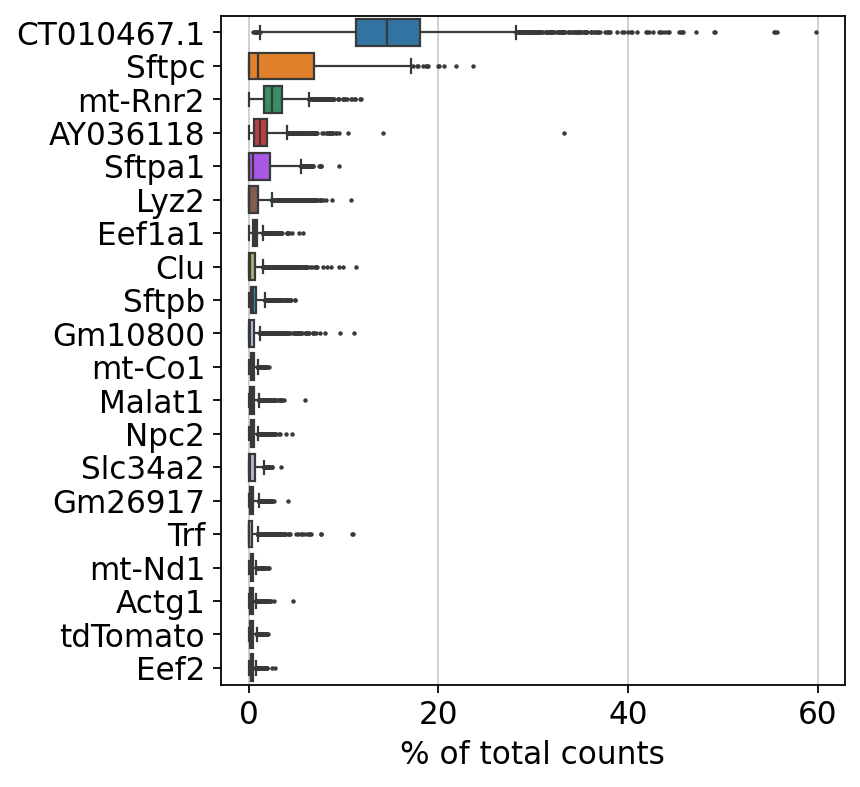

In [9]:
sc.pl.highest_expr_genes(adata, n_top=20, )

Basic filtering:

In [10]:
sc.pp.filter_cells(adata, min_genes=300)
sc.pp.filter_genes(adata, min_cells=3)

filtered out 18831 genes that are detected in less than 3 cells


In [11]:
adata.var['mt'] = adata.var_names.str.startswith('mt-') # annotate the group of mitochondrial genes as 'MT'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

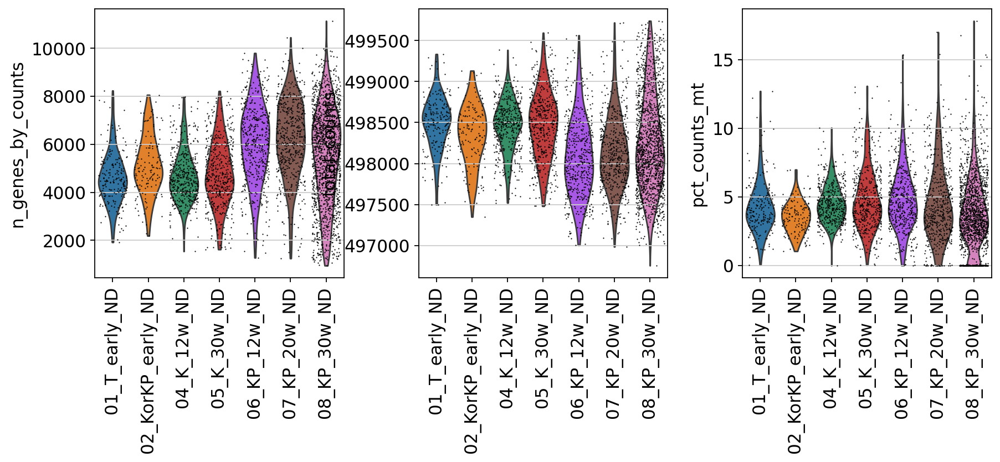

In [12]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True, groupby='timesimple',rotation=90)

(array([  10.,   43.,   47.,  100.,  182.,  547.,  979., 1121.,  780.,
          82.]),
 array([0.52252668, 0.54131873, 0.56011077, 0.57890281, 0.59769486,
        0.6164869 , 0.63527894, 0.65407099, 0.67286303, 0.69165507,
        0.71044712]),
 <BarContainer object of 10 artists>)

findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

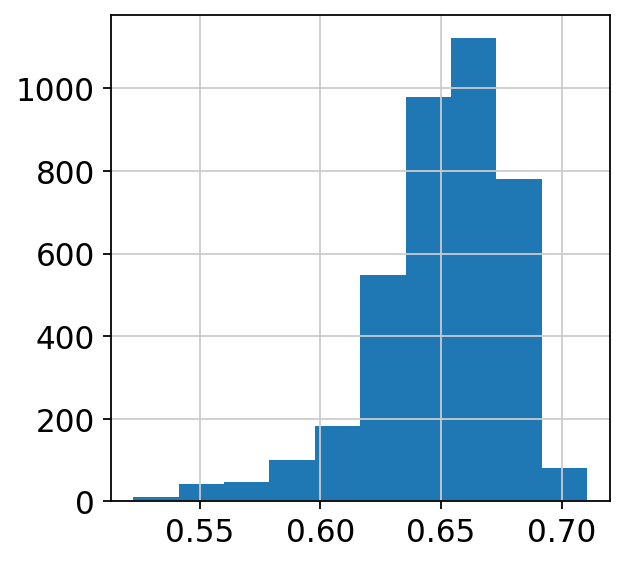

In [13]:
adata.obs["log10GenesPerUMI"] = adata.obs['n_genes_by_counts'].apply(math.log10) / adata.obs['total_counts'].apply(math.log10)
plt.pyplot.hist(adata.obs["log10GenesPerUMI"])

findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

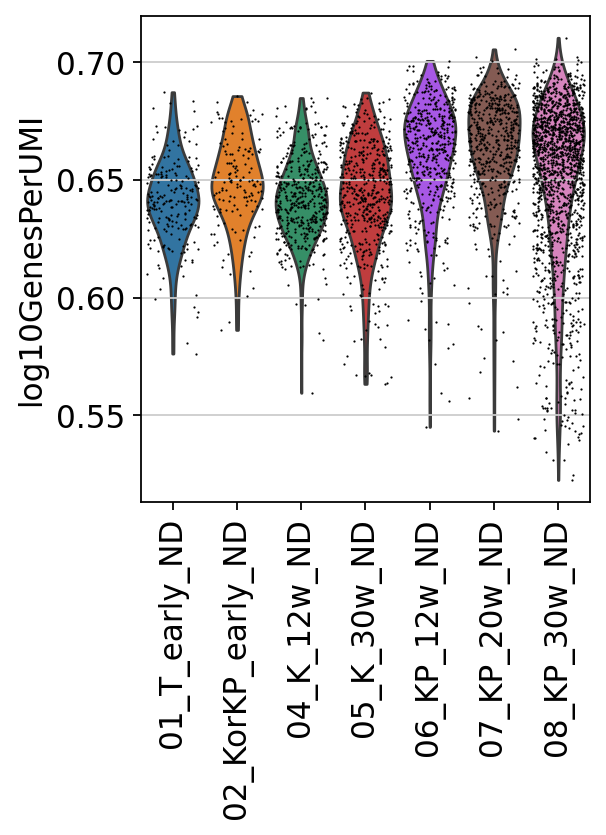

In [14]:
sc.pl.violin(adata, ['log10GenesPerUMI'],
             jitter=0.4, multi_panel=True, groupby='timesimple',rotation=90)
#99% seems like a good Human pct count cutoff

In [15]:
adata

AnnData object with n_obs × n_vars = 3891 × 33807
    obs: 'sampleID', 'plateID', 'mouseID', 'timesimple', 'typeID', 'clusterK12', 'tSNE_1', 'tSNE_2', 'phate_1', 'phate_2', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log10GenesPerUMI'
    var: 'geneID', 'geneSymbol', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'timesimple_colors'

In [16]:
#Filter by Log10GenesPerUMI
adata = adata[adata.obs.log10GenesPerUMI >= 0.6,:]

In [17]:
#adata = adata[adata.obs.n_genes_by_counts < 2500, :]
adata = adata[adata.obs.pct_counts_mt <= 10, :]

In [18]:
sc.pp.normalize_total(adata, target_sum=1e4)

/home/chanj2/part2/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:269: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)


In [19]:
adata.layers['counts'] = adata.X.copy()

In [20]:
sc.pp.log1p(adata)

In [21]:
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=4, min_disp=0.5)

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

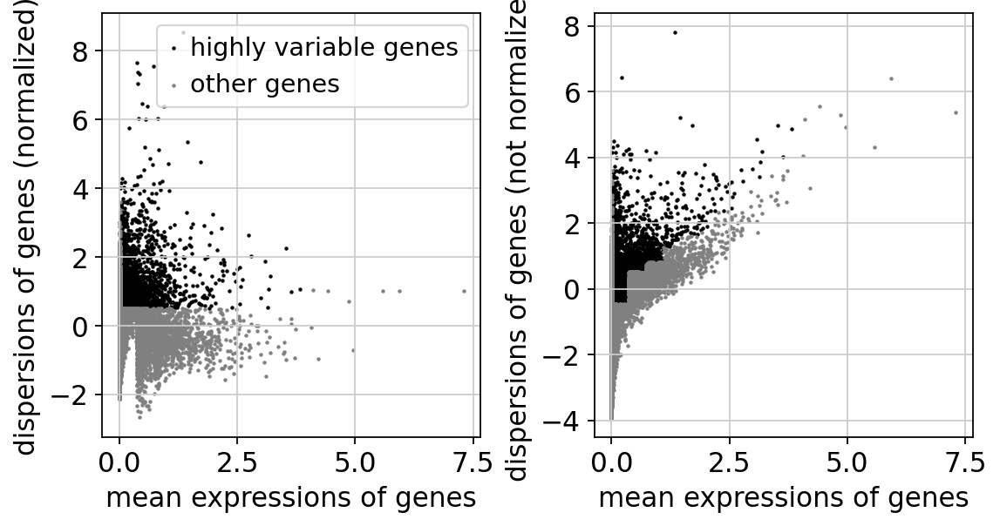

In [22]:
sc.pl.highly_variable_genes(adata)

In [23]:
adata.var.highly_variable['tdTomato'] = False

/tmp/ipykernel_2963680/4164286922.py:1: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata.var.highly_variable['tdTomato'] = False
/tmp/ipykernel_2963680/4164286922.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a s

In [24]:
adata.obs.clusterK12

KP_30w_ND_m3_T7_P1_S302           11
KP_30w_ND_m2_T4_P5_S331           12
K_12w_ND_m3_T0_P2_S272             5
KP_30w_ND_m2_T1_P4_S219           10
K_2w_ND_m3_T0_P1_S245              1
                                  ..
KP_20w_STb2_mAdCre1_T1_P2_S377     8
KP_20w_STb2_mAdCre1_T1_P2_S378     9
KP_20w_STb2_mAdCre1_T1_P2_S379     8
KP_20w_STb2_mAdCre1_T1_P2_S380     8
KP_20w_STb2_mAdCre1_T1_P2_S381     8
Name: clusterK12, Length: 3600, dtype: category
Categories (12, int64): [1, 2, 3, 4, ..., 9, 10, 11, 12]

In [25]:
# fix adata.obs.clusterK12 to be a string instead of an int
adata.rename_categories('clusterK12',["%02d" % x for x in range(1, 13)])

In [26]:
adata.obs.clusterK12

KP_30w_ND_m3_T7_P1_S302           11
KP_30w_ND_m2_T4_P5_S331           12
K_12w_ND_m3_T0_P2_S272            05
KP_30w_ND_m2_T1_P4_S219           10
K_2w_ND_m3_T0_P1_S245             01
                                  ..
KP_20w_STb2_mAdCre1_T1_P2_S377    08
KP_20w_STb2_mAdCre1_T1_P2_S378    09
KP_20w_STb2_mAdCre1_T1_P2_S379    08
KP_20w_STb2_mAdCre1_T1_P2_S380    08
KP_20w_STb2_mAdCre1_T1_P2_S381    08
Name: clusterK12, Length: 3600, dtype: category
Categories (12, object): ['01', '02', '03', '04', ..., '09', '10', '11', '12']

In [27]:
adata.raw = adata

In [28]:
sc.pp.scale(adata, max_value=10)

/home/chanj2/part2/lib/python3.11/functools.py:909: UserWarning: zero-centering a sparse array/matrix densifies it.
  return dispatch(args[0].__class__)(*args, **kw)


## Principal component analysis

In [29]:
sc.tl.pca(adata, svd_solver='arpack',n_comps=150)

computing PCA
    with n_comps=150
    finished (0:00:13)


findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

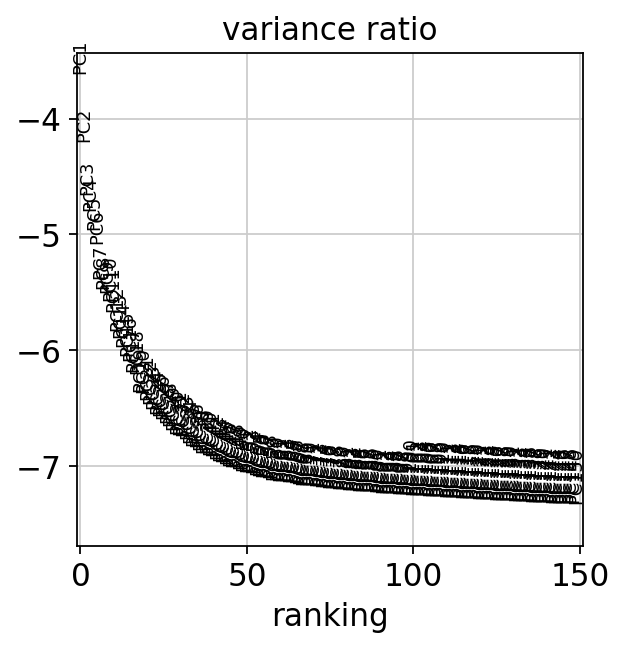

In [30]:
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=150)

## Computing the neighborhood graph

In [31]:
sc.pp.neighbors(adata, n_neighbors=50, n_pcs=60)

computing neighbors
    using 'X_pca' with n_pcs = 60


/home/chanj2/part2/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:04)


## Embedding the neighborhood graph

In [32]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:01:07)


In [33]:
sc.tl.leiden(adata, resolution=0.5)

running Leiden clustering


/tmp/ipykernel_2963680/1771924308.py:1: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, resolution=0.5)


    finished: found 9 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


In [34]:
adata

AnnData object with n_obs × n_vars = 3600 × 33807
    obs: 'sampleID', 'plateID', 'mouseID', 'timesimple', 'typeID', 'clusterK12', 'tSNE_1', 'tSNE_2', 'phate_1', 'phate_2', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log10GenesPerUMI', 'leiden'
    var: 'geneID', 'geneSymbol', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'timesimple_colors', 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'leiden'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

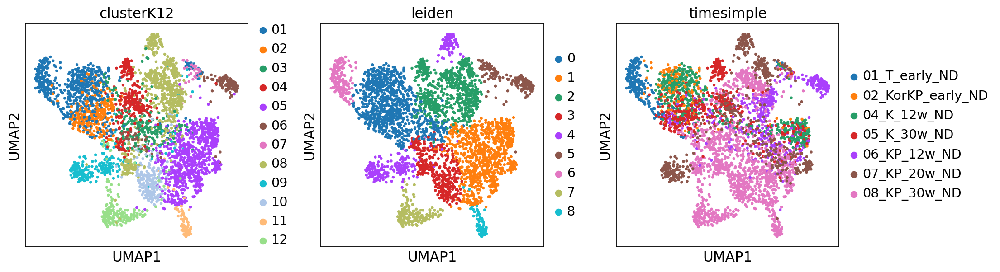

findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

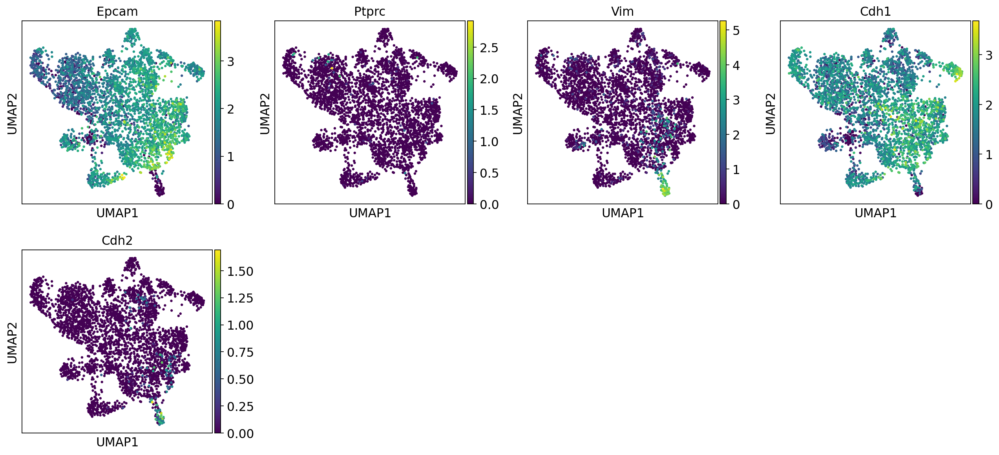

findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

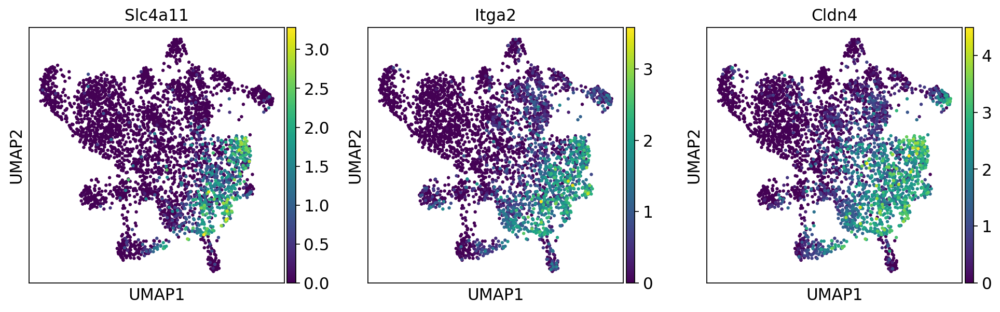

findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

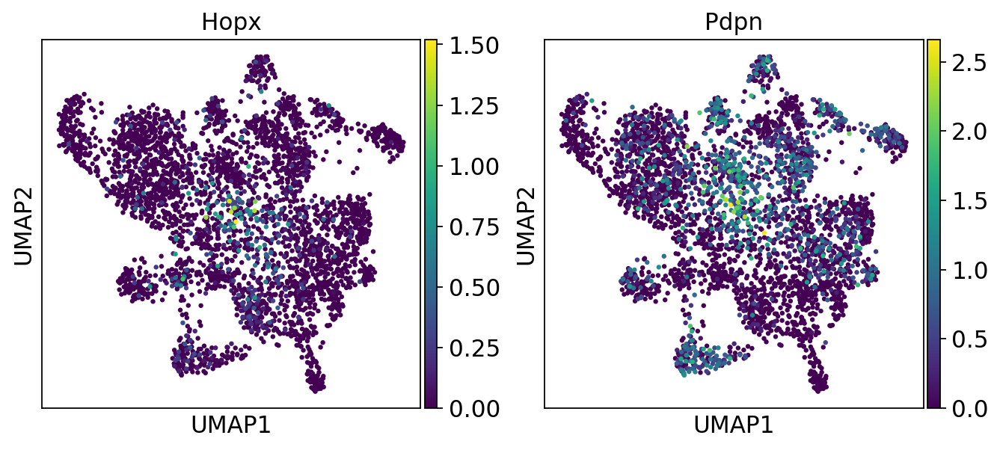

In [35]:
sc.pl.umap(adata, color=['clusterK12', 'leiden','timesimple', ])
sc.pl.umap(adata, color=['Epcam', 'Ptprc', 'Vim', 'Cdh1','Cdh2']) #CDH2 not found
sc.pl.umap(adata, color=['Slc4a11', 'Itga2', 'Cldn4']) #, 'Abcb1'
sc.pl.umap(adata, color=['Hopx', 'Pdpn'])

## Define Scoring Functions

In [36]:
# Score Cluster 5 cells
import csv
clusters = {}
clusterkeys = []
HPCS = False

def resetClusters(hpcs = 'cell2020'):
    clusters = {}
    clusterkeys = []
    HPCS = False
    try:
        if hpcs == 'cell2020':         
            with open('../common_files/clusters_cell2020.csv',encoding='utf-8-sig') as csvfile:
                csvreader = csv.reader(csvfile, delimiter=",")
                for row in csvreader:
                    clusters[row[0]] = [x for x in row[1:] if x != '']
            for i in range(1,13):
                #if i == 9: continue
                clusterkeys.append('Cluster %i' % i)
            HPCS = 'Cluster 5'
        elif hpcs == 'cell2020_no_goi':         
            with open('../common_files/clusters_cell2020_no_goi.csv',encoding='utf-8-sig') as csvfile:
                csvreader = csv.reader(csvfile, delimiter=",")
                for row in csvreader:
                    clusters[row[0]] = [x for x in row[1:] if x != '']   
            for i in range(1,13):
                #if i == 9: continue
                clusterkeys.append('Cluster %i' % i)
            HPCS = 'Cluster 5'
        elif hpcs == 'nfkb':         
            with open('../common_files/hallmark_tnfanfkb.csv',encoding='utf-8-sig') as csvfile:
                csvreader = csv.reader(csvfile, delimiter=",")
                row = list(csvreader)
                clusters['nfkb'] = [x[0] for x in row[0:] if x != '']   
            clusterkeys.append('nfkb')
            HPCS = 'nfkb'
        else:
            raise ValueError
    except ValueError:
        print("%s is an invalid choice" % hpcs)
        raise
    return (clusters, clusterkeys, HPCS)

(clusters, clusterkeys, HPCS) = resetClusters('cell2020')

In [37]:
def scoreAndPlot(ad, excludeList = None, groupby="clusterK12",rotation=90,numgenes=25,ctlgenes=25):
    #cmap = 'Reds' #colormap
    cmap = 'jet' #colormap
    if excludeList == None:
        for i in clusterkeys:
            if (numgenes > ctlgenes):
                ctlgenes = numgenes
            sc.tl.score_genes(ad, clusters[i][0:numgenes],score_name="%s" % i, ctrl_size=ctlgenes)
  
        sc.pl.umap(ad, color=clusterkeys, color_map=cmap)
        sc.pl.dotplot(ad, clusterkeys, groupby=groupby, swap_axes=True)

In [38]:
from scipy.stats import ranksums

def HPCSViolinPlot(ad, cluster='0', groupby='leiden', score='Cluster5', save=None, singleGene=False):
    ad.obs['Cl5'] = 'not HPCS'
    ad.obs.loc[ad.obs[groupby].isin([cluster]), 'Cl5'] = 'HPCS'

    if singleGene:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray(),ad[~ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray())[1]
    else:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])].obs[score],ad[ad.obs['Cl5'].isin(['not HPCS'])].obs[score])[1]
    sc.pl.violin(ad, score, groupby='Cl5', xlabel = 'p = ' + str(pvalue), save=save)

computing score 'Cluster 1'
    finished: added
    'Cluster 1', score of gene set (adata.obs).
    994 total control genes are used. (0:00:00)
computing score 'Cluster 2'
    finished: added
    'Cluster 2', score of gene set (adata.obs).
    892 total control genes are used. (0:00:00)
computing score 'Cluster 3'
    finished: added
    'Cluster 3', score of gene set (adata.obs).
    1194 total control genes are used. (0:00:00)
computing score 'Cluster 4'
    finished: added
    'Cluster 4', score of gene set (adata.obs).
    994 total control genes are used. (0:00:00)
computing score 'Cluster 5'
    finished: added
    'Cluster 5', score of gene set (adata.obs).
    892 total control genes are used. (0:00:00)
computing score 'Cluster 6'
    finished: added
    'Cluster 6', score of gene set (adata.obs).
    1190 total control genes are used. (0:00:00)
computing score 'Cluster 7'
    finished: added
    'Cluster 7', score of gene set (adata.obs).
    1089 total control genes are used.

findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

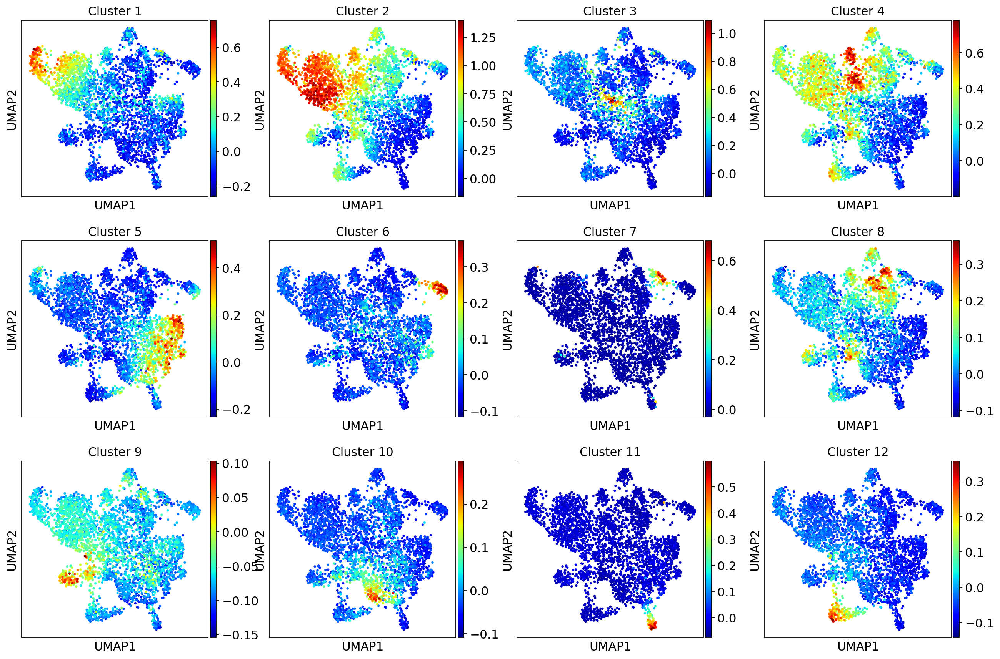

findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

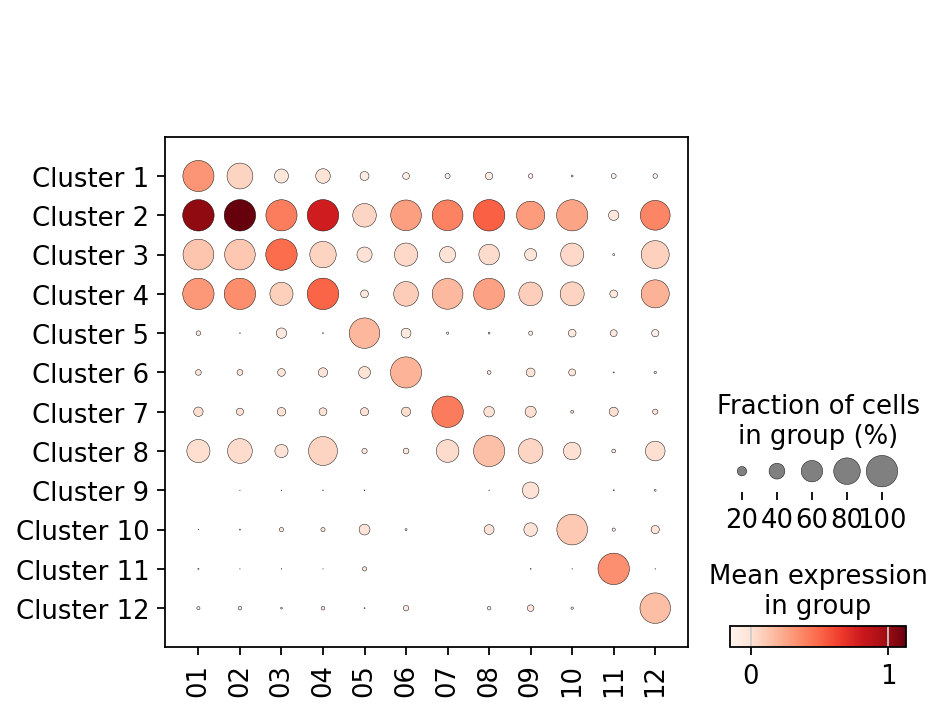

In [39]:
scoreAndPlot(adata,numgenes=100)

computing score 'nfkb'
    finished: added
    'nfkb', score of gene set (adata.obs).
    3766 total control genes are used. (0:00:00)


findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

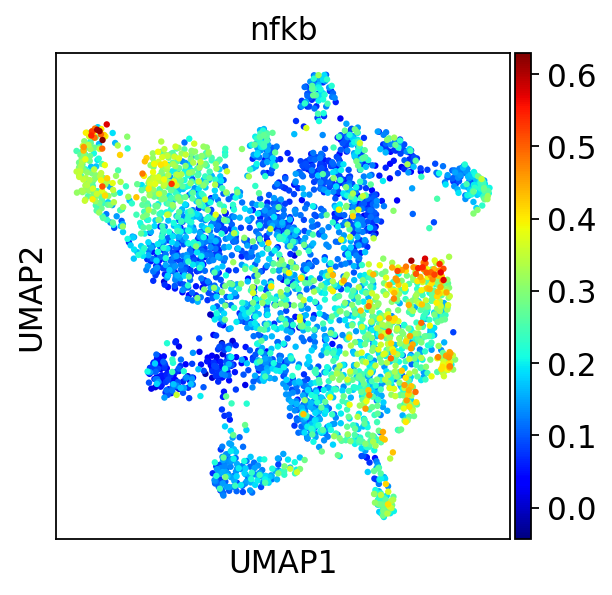

findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

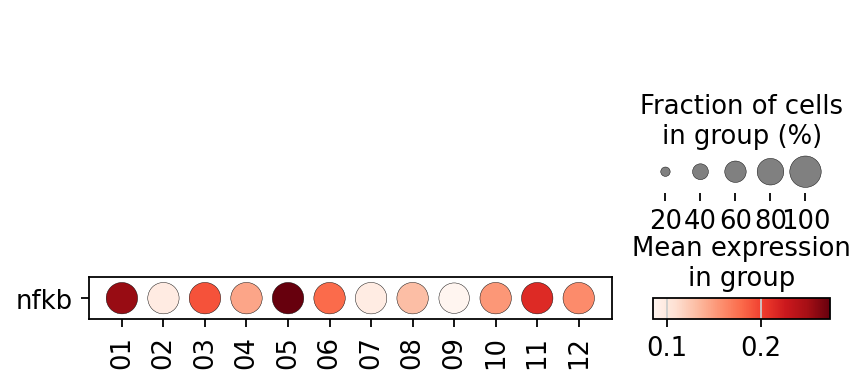

In [40]:
# Now calculate Nfkb score
(clusters, clusterkeys, HPCS) = resetClusters('nfkb')
scoreAndPlot(adata,numgenes=200)

## Clustering the neighborhood graph

findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

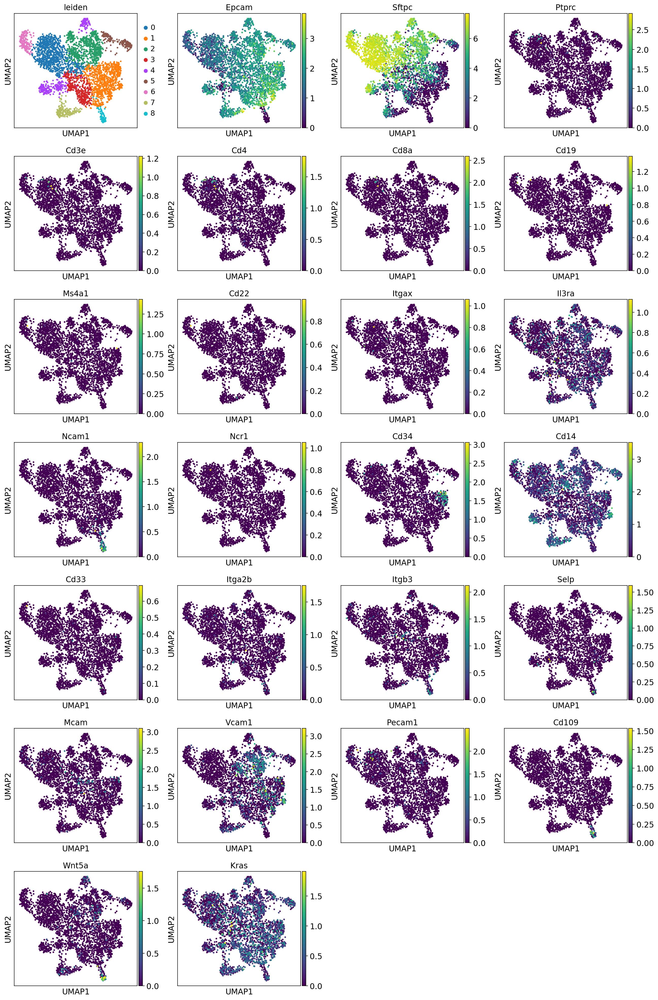

In [41]:
sc.pl.umap(adata, color=['leiden', 'Epcam', 'Sftpc', # Tumor cells
                         'Ptprc', #immune
                         'Cd3e', 'Cd4', 'Cd8a', #T cell
                         'Cd19', 'Ms4a1', 'Cd22', # B cell
                         'Itgax', 'Il3ra', # Dendritic Cell
                         'Ncam1', 'Ncr1', # NK Cell
                         'Cd34', # Hematopoetic stem cell
                         'Cd14', 'Cd33', # macrophage
                         #'Ceacam8' # Granulocyte
                         'Itga2b', 'Itgb3', 'Selp', #platelet
                         #'Gypa',  # erythrocyte
                         'Mcam', 'Vcam1', 'Pecam1', #'Sele', # endothelial cell
                         'Cd109', 'Wnt5a', 'Kras'])

findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

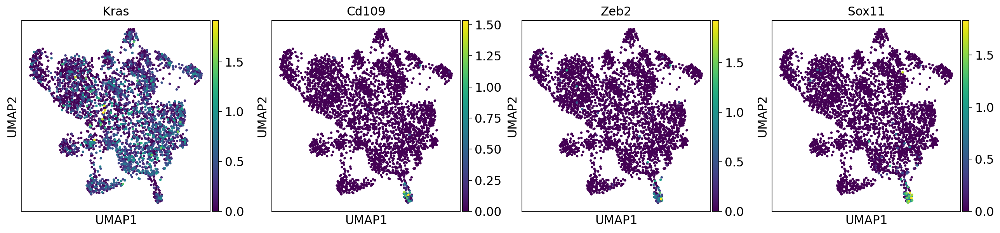

In [42]:
sc.pl.umap(adata, color=['Kras', 'Cd109', 'Zeb2', 'Sox11'])

findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

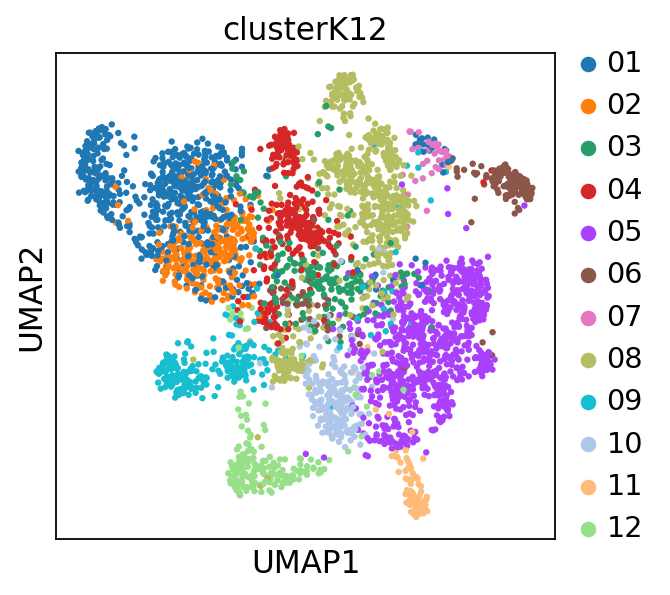

In [43]:
sc.pl.umap(adata, color=['clusterK12'])

## Finding marker genes

## Logistic Regression against Cancer Cell 2020 Clusters

In [44]:
goi = set()
with open('../common_files/clusters_cell2020.csv',encoding='utf-8-sig') as csvfile:
    csvreader = csv.reader(csvfile, delimiter=",")
    for row in csvreader:
        goi.update(row[1:])

In [45]:
goi.remove('')

In [46]:
from sklearn.model_selection import train_test_split

names_adata = adata[:,adata.var.index.isin(goi)]

X_train, X_test, y_train, y_test = train_test_split(names_adata.X, adata.obs['clusterK12'], test_size=0.25, random_state=250)

In [47]:
names = [x for x in names_adata.var.index]

In [48]:
# import the class
from sklearn.linear_model import LogisticRegression

# instantiate the model (using the default parameters)
#logreg = LogisticRegression(random_state=250,multi_class='multinomial',solver='saga')
logreg = LogisticRegression(random_state=250,multi_class='multinomial',solver='lbfgs')

# fit the model with data
logreg.fit(X_train, y_train)

y_pred = logreg.predict(X_test)
y_score = logreg.predict_proba(X_test)


/home/chanj2/part2/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1272: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.8. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(


In [49]:
# import the metrics class
from sklearn import metrics

cnf_matrix = metrics.confusion_matrix(y_test, y_pred)
cnf_matrix

array([[142,   6,   1,   0,   1,   1,   1,   0,   0,   0,   0,   0],
       [  8,  69,   0,   3,   0,   0,   0,   0,   0,   0,   0,   0],
       [  0,   0,  41,   0,   3,   0,   0,   2,   0,   1,   0,   0],
       [  1,   1,   0,  67,   0,   0,   0,   7,   1,   0,   0,   0],
       [  1,   0,   3,   0, 181,   1,   0,   2,   0,   0,   0,   1],
       [  0,   0,   0,   1,   0,  33,   0,   0,   0,   0,   0,   0],
       [  0,   0,   0,   0,   0,   0,  15,   0,   0,   0,   0,   0],
       [  0,   0,   1,   3,   1,   0,   0, 137,   1,   0,   0,   1],
       [  0,   0,   0,   1,   1,   0,   0,   1,  38,   1,   0,   0],
       [  0,   0,   1,   1,   3,   0,   0,   3,   0,  54,   0,   1],
       [  0,   0,   0,   0,   0,   0,   0,   0,   1,   0,  13,   0],
       [  0,   0,   0,   0,   1,   0,   0,   0,   0,   0,   0,  42]])

findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

Text(0.5, 295.64444444444445, 'Predicted label')

findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

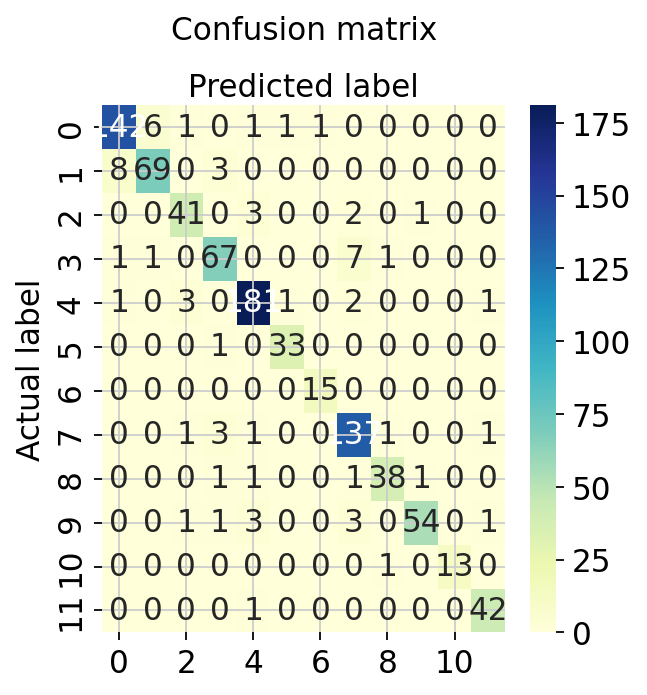

In [50]:
# import required modules
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

class_names=[0,1] # name  of classes
fig, ax = plt.subplots()
tick_marks = np.arange(len(class_names))
plt.xticks(tick_marks, class_names)
plt.yticks(tick_marks, class_names)
# create heatmap
sns.heatmap(pd.DataFrame(cnf_matrix), annot=True, cmap="YlGnBu" ,fmt='g')
ax.xaxis.set_label_position("top")
plt.tight_layout()
plt.title('Confusion matrix', y=1.1)
plt.ylabel('Actual label')
plt.xlabel('Predicted label')

#Text(0.5,257.44,'Predicted label');

In [51]:
from sklearn.metrics import classification_report
target_names = ['1', '2', '3','4','5','6','7','8','9','10','11','12']
print(classification_report(y_test, y_pred, target_names=target_names))

              precision    recall  f1-score   support

           1       0.93      0.93      0.93       152
           2       0.91      0.86      0.88        80
           3       0.87      0.87      0.87        47
           4       0.88      0.87      0.88        77
           5       0.95      0.96      0.95       189
           6       0.94      0.97      0.96        34
           7       0.94      1.00      0.97        15
           8       0.90      0.95      0.93       144
           9       0.93      0.90      0.92        42
          10       0.96      0.86      0.91        63
          11       1.00      0.93      0.96        14
          12       0.93      0.98      0.95        43

    accuracy                           0.92       900
   macro avg       0.93      0.92      0.93       900
weighted avg       0.92      0.92      0.92       900



In [52]:
from sklearn.preprocessing import LabelBinarizer

label_binarizer = LabelBinarizer().fit(y_train)
y_onehot_test = label_binarizer.transform(y_test)
y_onehot_test.shape  # (n_samples, n_classes)

(900, 12)

In [53]:
label_binarizer.classes_

array(['01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11',
       '12'], dtype='<U2')

In [54]:
class_of_interest = '07'
class_id = np.flatnonzero(label_binarizer.classes_ == class_of_interest)[0]
class_id

np.int64(6)

/home/chanj2/part2/lib/python3.11/site-packages/sklearn/utils/_plotting.py:175: FutureWarning: `**kwargs` is deprecated and will be removed in 1.9. Pass all matplotlib arguments to `curve_kwargs` as a dictionary instead.
  warnings.warn(
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'A

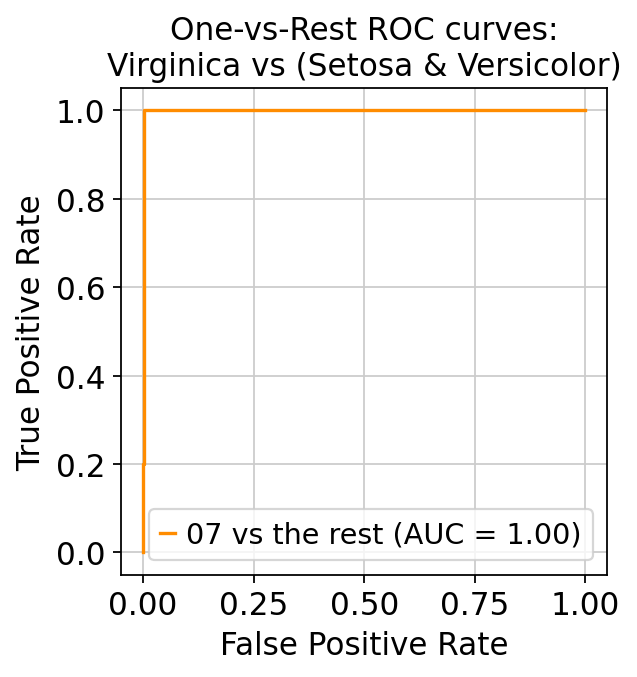

In [55]:
import matplotlib.pyplot as plt

from sklearn.metrics import RocCurveDisplay

RocCurveDisplay.from_predictions(
    y_onehot_test[:, class_id],
    y_score[:, class_id],
    name=f"{class_of_interest} vs the rest",
    color="darkorange",
    #plot_chance_level=True,
)
plt.axis("square")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("One-vs-Rest ROC curves:\nVirginica vs (Setosa & Versicolor)")
plt.legend()
plt.show()

In [56]:
## Now write logit classifier to load later
from joblib import dump, load
#dump(logreg, '../common_files/cancerCell2020Logreg.joblib')
dump(names, '../common_files/genes.joblib')

['../common_files/genes.joblib']

## Plot on PHATE Map Coordinates

In [57]:
# setup coordinate system for PHATE map
adata.obsm['X_phate'] = adata.obs[['phate_1','phate_2']].values

## Write h5ad file

In [58]:
adata.write(results_file, compression='gzip')

## Compare Plaur and Plau, K vs KP in HPCS

In [59]:
adata2 = adata.copy()

In [60]:
adata2

AnnData object with n_obs × n_vars = 3600 × 33807
    obs: 'sampleID', 'plateID', 'mouseID', 'timesimple', 'typeID', 'clusterK12', 'tSNE_1', 'tSNE_2', 'phate_1', 'phate_2', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log10GenesPerUMI', 'leiden', 'Cluster 1', 'Cluster 2', 'Cluster 3', 'Cluster 4', 'Cluster 5', 'Cluster 6', 'Cluster 7', 'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12', 'nfkb'
    var: 'geneID', 'geneSymbol', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'timesimple_colors', 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'leiden', 'clusterK12_colors', 'leiden_colors'
    obsm: 'X_pca', 'X_umap', 'X_phate'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [61]:
adata2.obs.timesimple.value_counts()

timesimple
08_KP_30w_ND         1372
07_KP_20w_ND          508
06_KP_12w_ND          468
05_K_30w_ND           468
04_K_12w_ND           448
01_T_early_ND         196
02_KorKP_early_ND     140
Name: count, dtype: int64

In [62]:
adata2.obs['KP'] = ["K" if x else "KP" for x in adata2.obs['typeID'].isin(['05_K_30w_ND','04_K_12w_ND','02_K_2w_ND'])] 

In [63]:
adata2 = adata2[~adata2.obs.timesimple.isin(['01_T_early_ND','02_KorKP_early_ND']),:]

/home/chanj2/part2/lib/python3.11/site-packages/anndata/_core/anndata.py:1180: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Aria

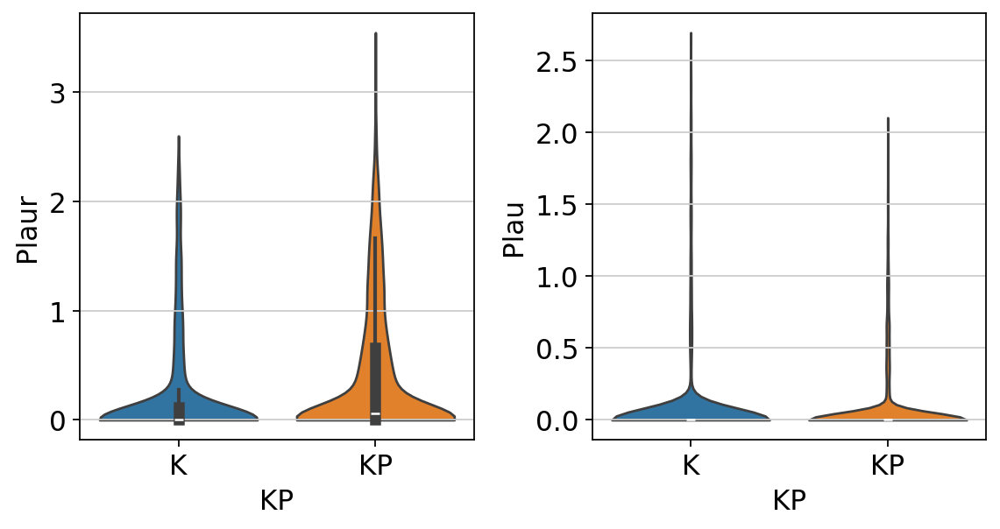

findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

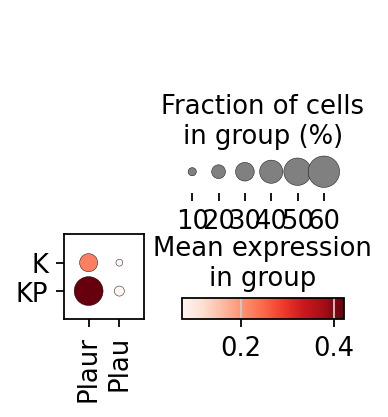

In [64]:
sc.pl.violin(adata2,['Plaur','Plau'],groupby='KP',inner='box',stripplot=False)
sc.pl.dotplot(adata2,['Plaur','Plau'],groupby='KP')

findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

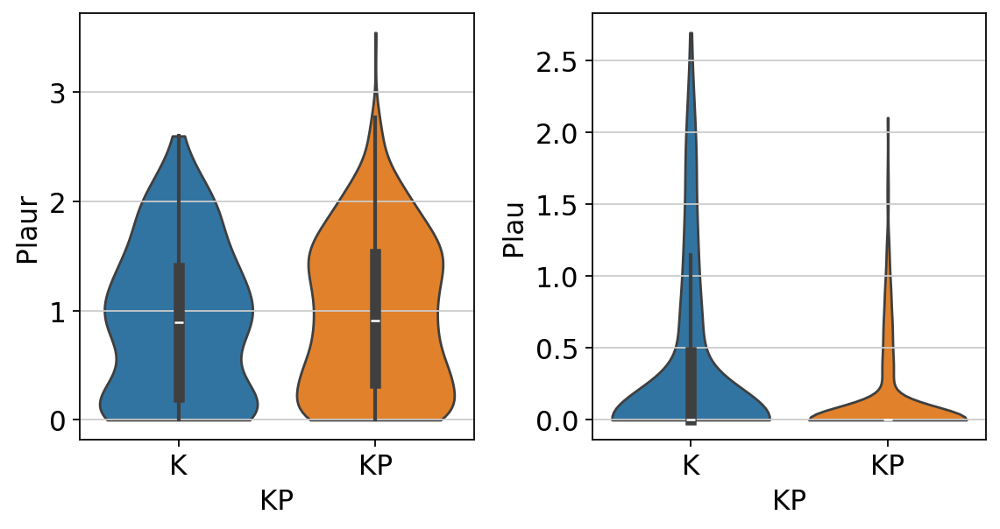

findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

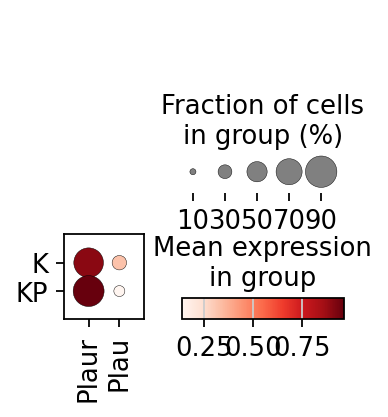

In [65]:
sc.pl.violin(adata2[adata2.obs.clusterK12.isin(['05']),:],['Plaur','Plau'],groupby='KP',inner='box',stripplot=False)
sc.pl.dotplot(adata2[adata2.obs.clusterK12.isin(['05']),:],['Plaur','Plau'],groupby='KP')

In [66]:
adata2.obs.timesimple.value_counts()

timesimple
08_KP_30w_ND    1372
07_KP_20w_ND     508
06_KP_12w_ND     468
05_K_30w_ND      468
04_K_12w_ND      448
Name: count, dtype: int64

In [67]:
adata2 = adata2[~adata2.obs.timesimple.isin(['07_KP_20w_ND']),:]

findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

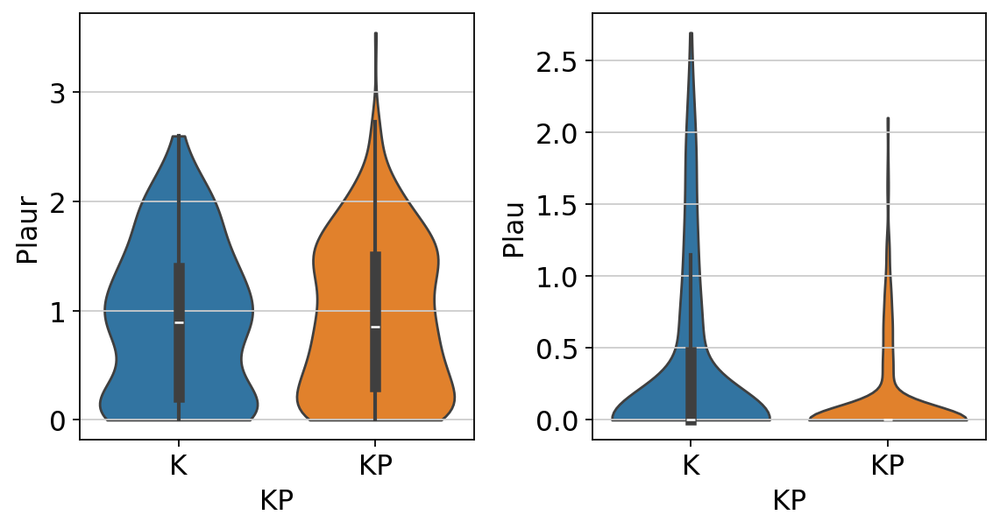

In [68]:
sc.pl.violin(adata2[adata2.obs.clusterK12.isin(['05']),:],['Plaur','Plau'],groupby='KP',inner='box',stripplot=False)

findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

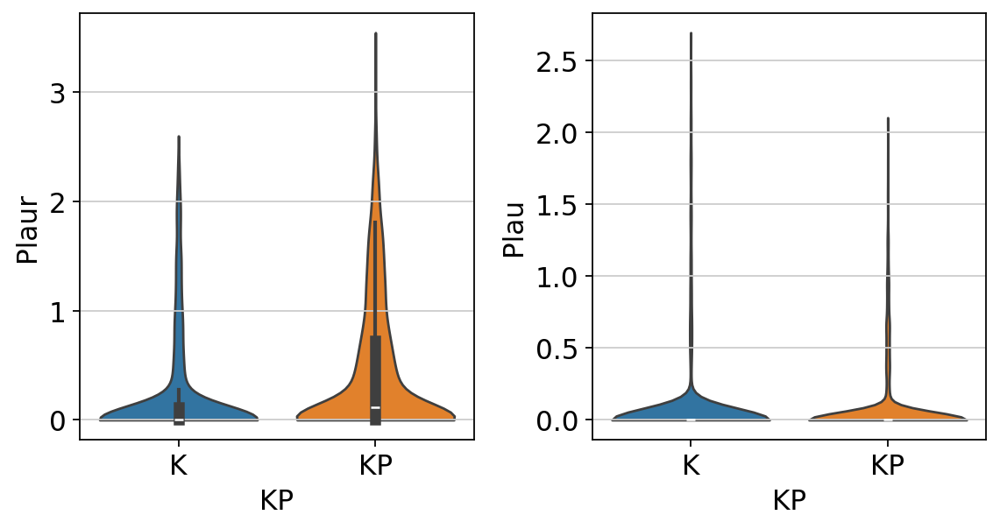

In [69]:
sc.pl.violin(adata2,['Plaur','Plau'],groupby='KP',inner='box',stripplot=False)

findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

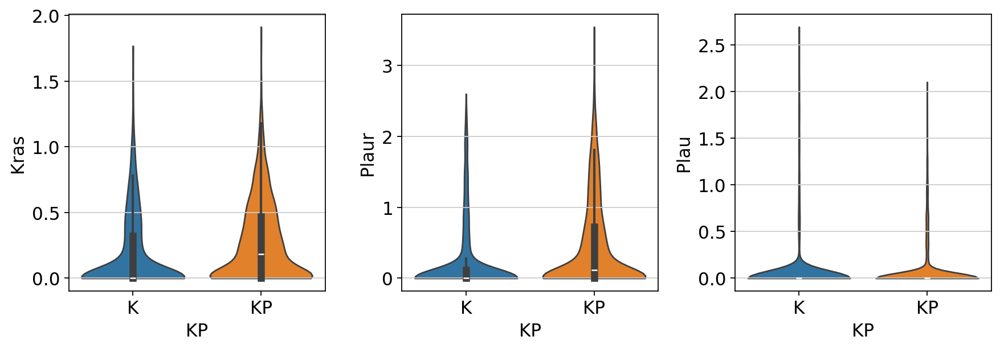

In [70]:
sc.pl.violin(adata2,['Kras','Plaur','Plau'],groupby='KP',inner='box',stripplot=False)

## Cellrank v2 Analysis

In [71]:
adata.obs.timesimple.value_counts()

timesimple
08_KP_30w_ND         1372
07_KP_20w_ND          508
06_KP_12w_ND          468
05_K_30w_ND           468
04_K_12w_ND           448
01_T_early_ND         196
02_KorKP_early_ND     140
Name: count, dtype: int64

In [72]:
from pathlib import Path

In [73]:
Path("./figures").mkdir(parents=True, exist_ok=True) # generate figures here

### Plot genes

findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

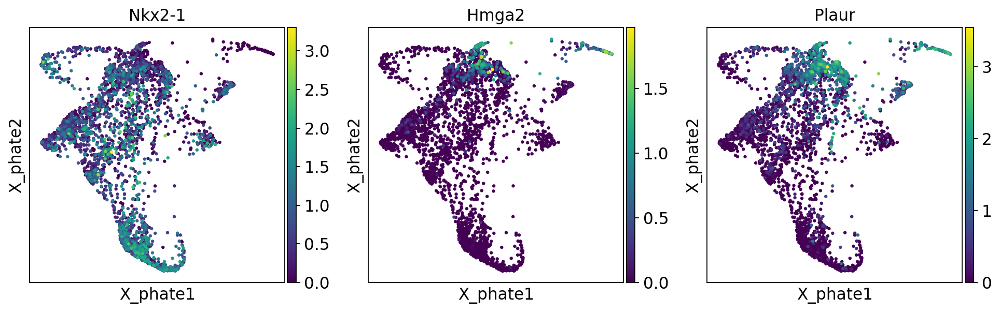

In [74]:
sc.pl.embedding(adata, color=['Nkx2-1','Hmga2','Plaur'],basis='X_phate')

In [75]:
def plotPhate(adata, goi,timesimple=None,save=False):
    emb = None
    goi_expr = None
    if not timesimple:
        emb = adata.obsm["X_phate"]  # Replace "X_umap" with your embedding basis
        goi_expr = adata[:, goi].X.flatten()
    else:
        emb = adata[adata.obs.timesimple == timesimple,:].obsm["X_phate"]  # Replace "X_umap" with your embedding basis
        goi_expr = adata[adata.obs.timesimple == timesimple, goi].X.flatten()
    #goi_expr = adata[:, goi].X.flatten()

    # Normalize the expression levels for better contrast
    #goi_norm = (goi_expr - np.min(goi_expr)) / (np.max(goi_expr) - np.min(goi_expr))

    # Create the plot
    plt.figure(figsize=(4, 4))

    # Overlay cells
    plt.scatter(emb[:, 0], emb[:, 1], color='lightgrey', alpha=0.5, label="other")

    # Overlay gene of interest expression
    #normalized
    #plt.scatter(emb[:, 0], emb[:, 1], c=goi_norm, alpha=0.5, label=f"{goi}",cmap='Reds')
    plt.scatter(emb[:, 0], emb[:, 1], c=goi_expr, vmin=np.min(adata[:, goi].X.flatten()), vmax=np.max(adata[:, goi].X.flatten()),alpha=0.5, label=f"{goi}",cmap='Reds')
    ax = plt.gca()
    ax.set_xlim([-0.6, 0.85])
    ax.set_ylim([-0.8, 0.65])
    # Add labels, legend, and title
    plt.xlabel("PHATE1")
    plt.ylabel("PHATE2")
    #plt.legend(loc="lower right")
    plt.title(f"{timesimple} {goi}")
    plt.colorbar(label="Expression Level")
    plt.grid(False)
    plt.tight_layout()
    if save:
        plt.savefig(f"figures/{timesimple}_{goi}.svg")
    plt.show()
    

### Palantir Pseudotime

In [76]:
oldadata = adata.copy()
adata = adata[~adata.obs.timesimple.isin(['04_K_12w_ND', '05_K_30w_ND']),:].copy()

In [77]:
import palantir

In [78]:
dm_res = palantir.utils.run_diffusion_maps(adata, n_components=5)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)


In [79]:
ms_data = palantir.utils.determine_multiscale_space(adata)

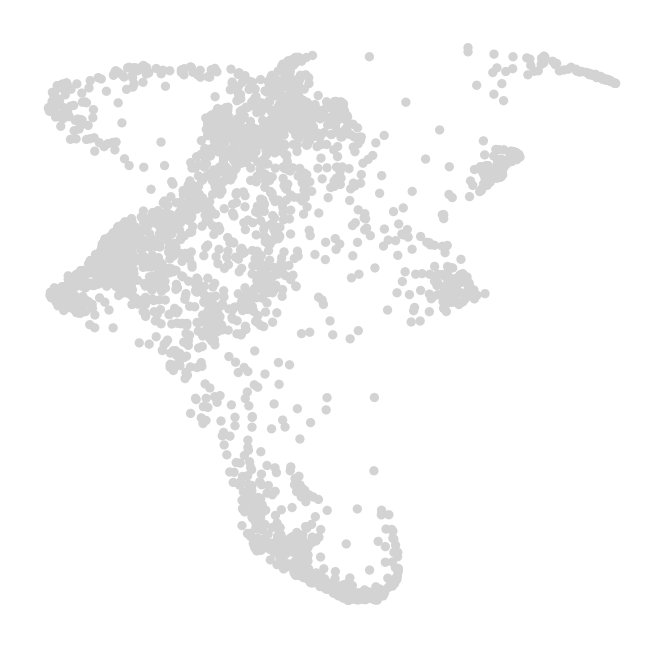

In [80]:
# Use scanpy functions to visualize umaps or FDL
sc.pl.embedding(
    adata,
    basis="X_phate",
    frameon=False,
)

findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.


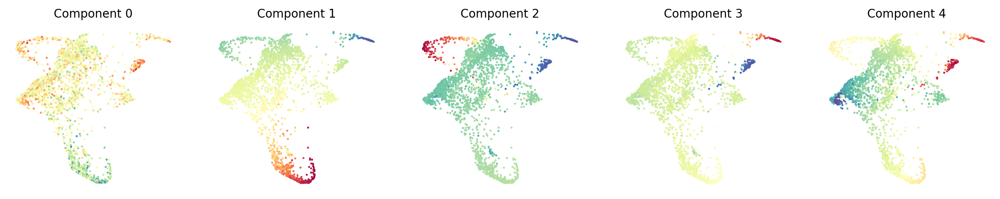

In [81]:
palantir.plot.plot_diffusion_components(adata,embedding_basis='X_phate')
plt.show()

findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

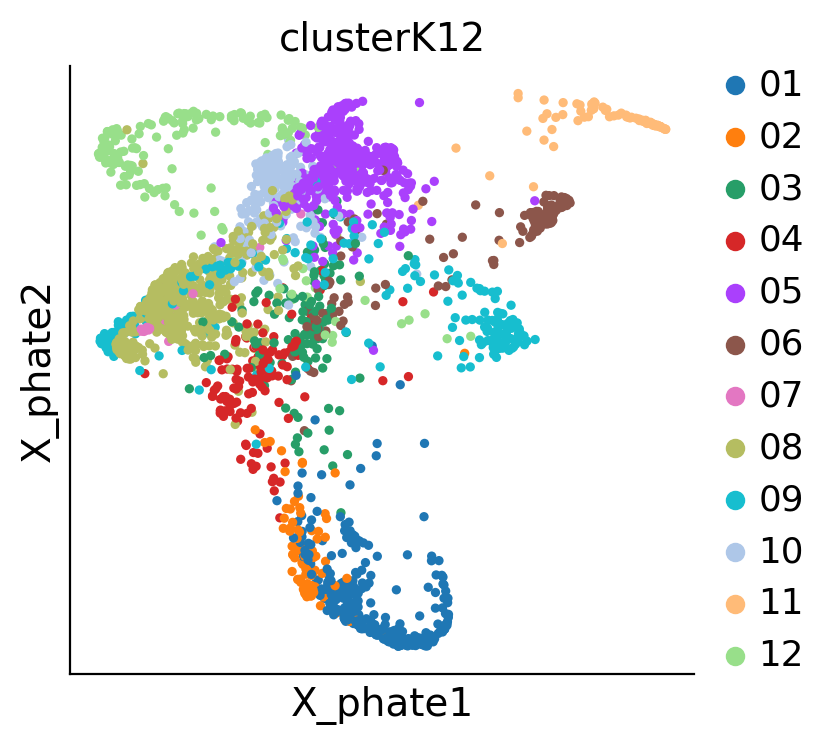

In [82]:
sc.pl.embedding(adata, color=['clusterK12'],basis='X_phate')

In [83]:
start_cell = "T_0w_ND_f1_T0_P1_S65"
pr_res = palantir.core.run_palantir(
    adata, start_cell, num_waypoints=500,
)

Sampling and flocking waypoints...
Time for determining waypoints: 0.0023712793986002604 minutes
Determining pseudotime...
Shortest path distances using 30-nearest neighbor graph...
Time for shortest paths: 0.05353141228357951 minutes
Iteratively refining the pseudotime...
Correlation at iteration 1: 1.0000
Entropy and branch probabilities...
Markov chain construction...
Identification of terminal states...
Computing fundamental matrix and absorption probabilities...
Project results to all cells...


(<Figure size 600x600 with 1 Axes>, <Axes: >)

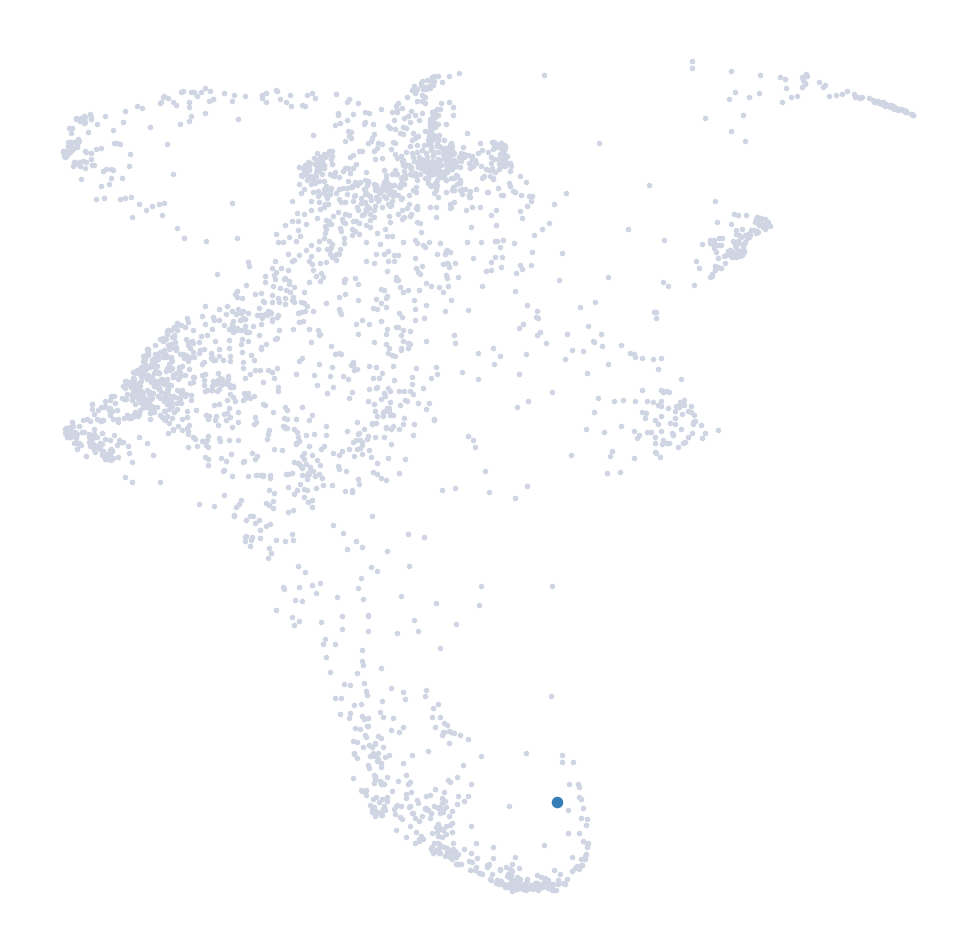

In [84]:
palantir.plot.highlight_cells_on_umap(adata, [start_cell],embedding_basis='X_phate')

findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

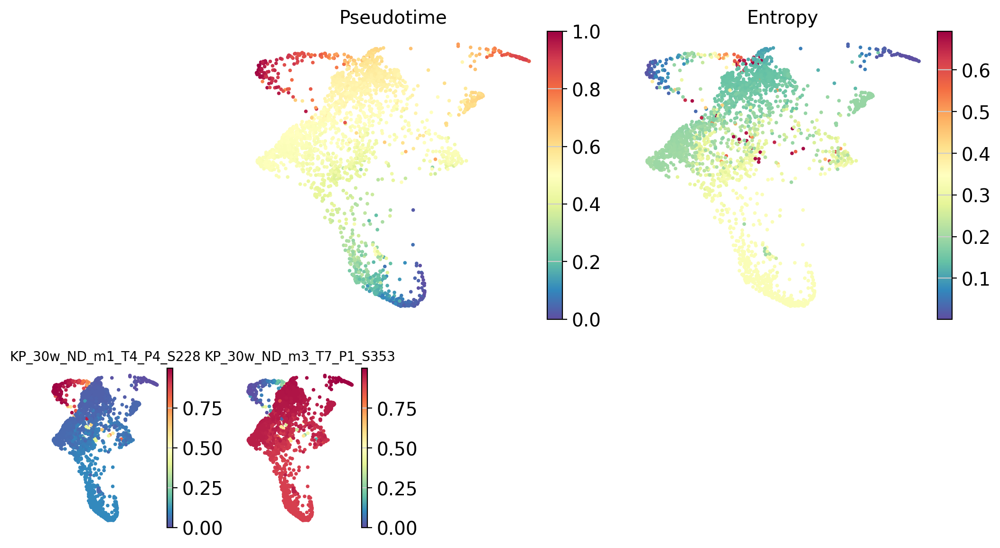

In [85]:
palantir.plot.plot_palantir_results(adata, embedding_basis='X_phate',s=3)
plt.show()

In [86]:
masks = palantir.presults.select_branch_cells(adata, q=.01, eps=.01)

findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

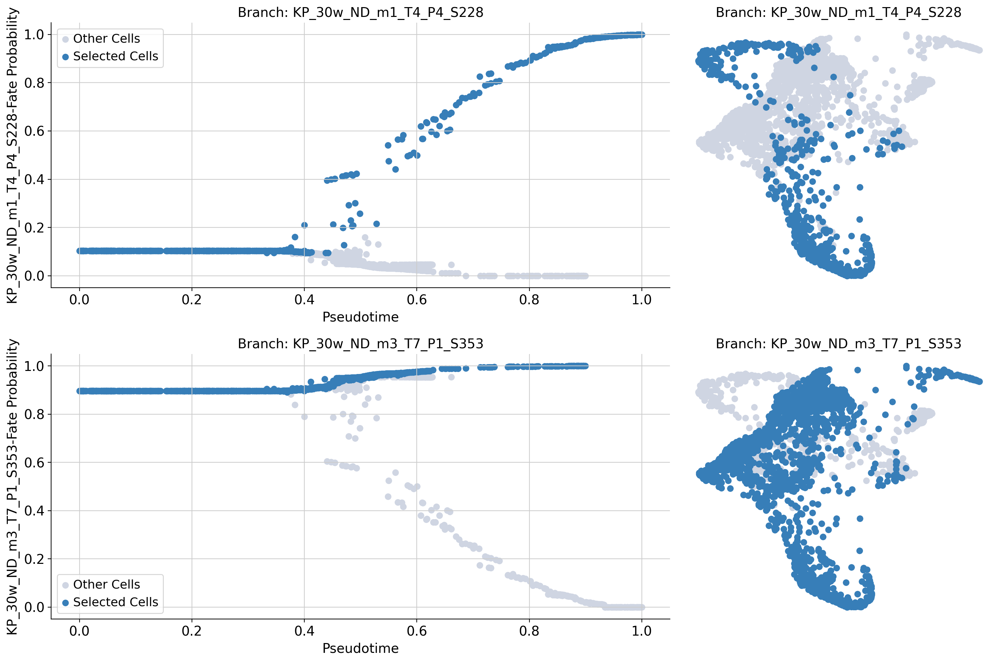

In [87]:
palantir.plot.plot_branch_selection(adata,embedding_basis='X_phate')
plt.show()

In [88]:
gene_trends = palantir.presults.compute_gene_trends(adata)

/home/chanj2/part2/lib/python3.11/site-packages/palantir/presults.py:270: FutureWarning: Use obs (e.g. `k in adata.obs` or `str(adata.obs.columns.tolist())`) instead of AnnData.obs_keys, AnnData.obs_keys is deprecated and will be removed in the future.
  if pseudo_time_key not in ad.obs_keys():


KP_30w_ND_m1_T4_P4_S228
[2025-12-12 11:36:56,456] [INFO    ] Using sparse Gaussian Process since n_landmarks (500) < n_samples (692) and rank = 1.0.
[2025-12-12 11:36:56,457] [INFO    ] Using covariance function Matern52(ls=1.0).
[2025-12-12 11:36:58,068] [INFO    ] Sigma interpreted as element-wise standard deviation.
KP_30w_ND_m3_T7_P1_S353
[2025-12-12 11:37:00,946] [INFO    ] Using sparse Gaussian Process since n_landmarks (500) < n_samples (2,167) and rank = 1.0.
[2025-12-12 11:37:00,948] [INFO    ] Using covariance function Matern52(ls=1.0).
[2025-12-12 11:37:01,590] [INFO    ] Sigma interpreted as element-wise standard deviation.


findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

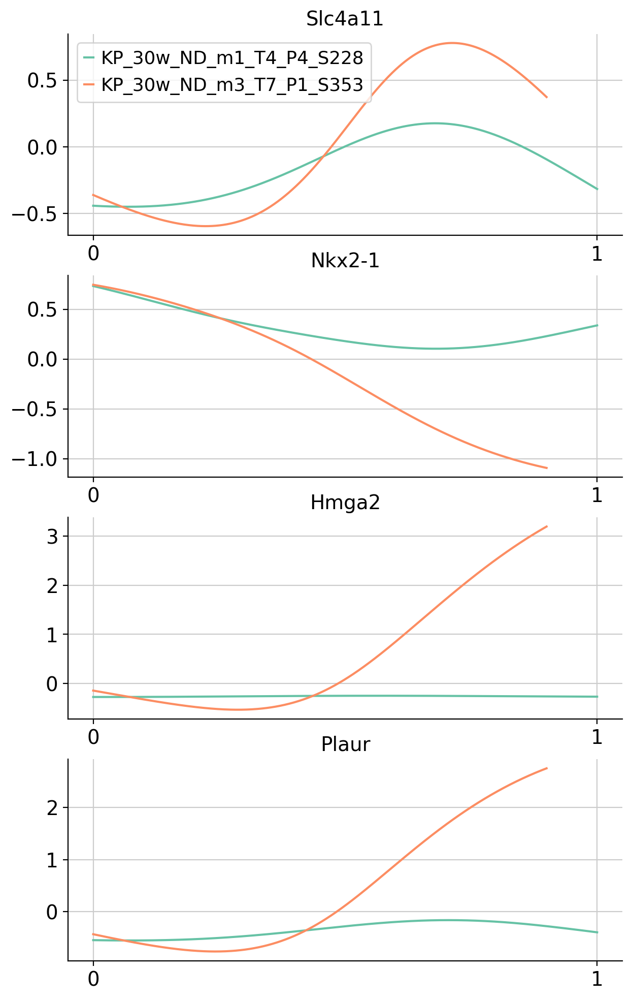

In [89]:
genes=['Slc4a11','Nkx2-1','Hmga2','Plaur']
palantir.plot.plot_gene_trends(adata, genes)
plt.show()

findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

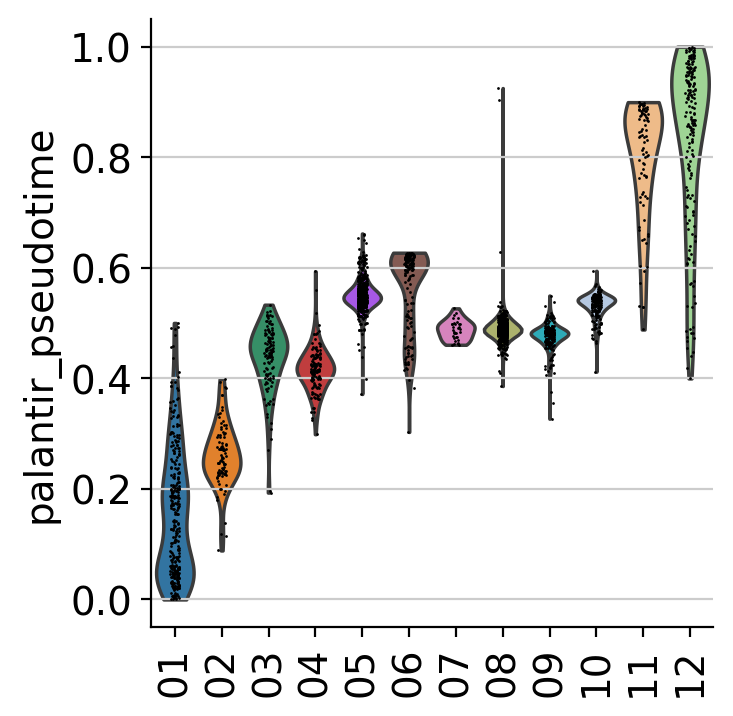

In [90]:
sc.pl.violin(adata, keys=["palantir_pseudotime"], groupby="clusterK12", rotation=90)

In [91]:
adata

AnnData object with n_obs × n_vars = 2684 × 33807
    obs: 'sampleID', 'plateID', 'mouseID', 'timesimple', 'typeID', 'clusterK12', 'tSNE_1', 'tSNE_2', 'phate_1', 'phate_2', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log10GenesPerUMI', 'leiden', 'Cluster 1', 'Cluster 2', 'Cluster 3', 'Cluster 4', 'Cluster 5', 'Cluster 6', 'Cluster 7', 'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12', 'nfkb', 'palantir_pseudotime', 'palantir_entropy'
    var: 'geneID', 'geneSymbol', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'timesimple_colors', 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'leiden', 'clusterK12_colors', 'leiden_colors', 'DM_EigenValues', 'palantir_waypoints'
    obsm: 'X_pca', 'X_umap', 'X_phate', 'DM_EigenVectors', 'DM_EigenVectors_multiscaled', 'palantir_fate_probabilities', 'branch_masks'
   

### CellRank v2 - palantir

In [92]:
import cellrank as cr

In [93]:
from cellrank.kernels import RealTimeKernel

In [94]:
from moscot.problems.time import TemporalProblem

findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

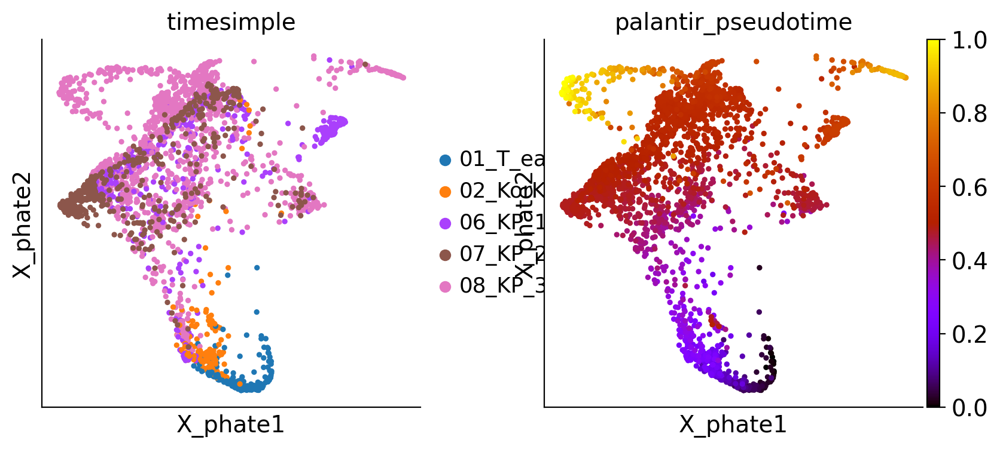

In [95]:
sc.pl.embedding(
    adata,
    basis="X_phate",
    color=["timesimple", "palantir_pseudotime"],
    color_map="gnuplot",
)

In [96]:
adata.obs.timesimple.cat.categories

Index(['01_T_early_ND', '02_KorKP_early_ND', '06_KP_12w_ND', '07_KP_20w_ND',
       '08_KP_30w_ND'],
      dtype='object')

In [97]:
tp = TemporalProblem(adata)

In [98]:
tp = tp.score_genes_for_marginals(
    gene_set_proliferation="mouse", gene_set_apoptosis="mouse"
)

computing score 'proliferation'
    finished: added
    'proliferation', score of gene set (adata.obs).
    595 total control genes are used. (0:00:00)
computing score 'apoptosis'
    finished: added
    'apoptosis', score of gene set (adata.obs).
    794 total control genes are used. (0:00:00)


findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

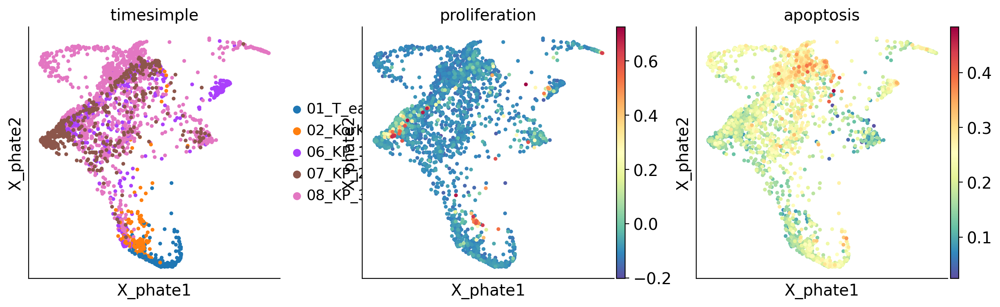

In [99]:
sc.pl.embedding(
    adata, basis="X_phate", color=["timesimple", "proliferation", "apoptosis"]
)

In [100]:
def extract_time(label):
    if 'w' in label:
        # Get number before 'w', e.g. '12w' → 12
        return int(label.split('_')[2].replace('w', ''))
    else:
        # Otherwise use the numeric prefix (e.g. '01_' → 1)
        return int(label.split('_')[0])

In [101]:
adata.obs['time'] = adata.obs['timesimple'].apply(extract_time)

In [102]:
adata.obs['time']= adata.obs['time'].cat.rename_categories({1:0, 2:2, 12:12, 20:20, 30:30})
adata.obs['time'] = pd.to_numeric(adata.obs['time'], errors='coerce')

In [103]:
tp = tp.prepare(time_key="time")

INFO     Computing pca with `n_comps=30` for `xy` using `adata.X`                                                  
computing PCA
    with n_comps=30
    finished (0:00:01)
INFO     Computing pca with `n_comps=30` for `xy` using `adata.X`                                                  
computing PCA
    with n_comps=30
    finished (0:00:05)
INFO     Computing pca with `n_comps=30` for `xy` using `adata.X`                                                  
computing PCA
    with n_comps=30
    finished (0:00:02)
INFO     Computing pca with `n_comps=30` for `xy` using `adata.X`                                                  
computing PCA
    with n_comps=30
    finished (0:00:03)


In [104]:
tp = tp.solve(epsilon=1e-3, tau_a=0.95, scale_cost="mean")

INFO     Solving `4` problems                                                                                      
INFO     Solving problem BirthDeathProblem[stage='prepared', shape=(196, 140)].                                    
INFO     Solving problem BirthDeathProblem[stage='prepared', shape=(508, 1372)].                                   
INFO     Solving problem BirthDeathProblem[stage='prepared', shape=(140, 468)].                                    
INFO     Solving problem BirthDeathProblem[stage='prepared', shape=(468, 508)].                                    


In [105]:
tmk = RealTimeKernel.from_moscot(tp)

In [106]:
tmk.compute_transition_matrix(self_transitions="all", conn_weight=0.2, threshold="auto")

100%|██████████| 4/4 [00:00<00:00, 47127.01time pair/s]

Using automatic `threshold=1.0506214432787605e-136`


RealTimeKernel[n=2684, threshold='auto', self_transitions='all']

Simulating `100` random walks of maximum length `500`


100%|██████████| 100/100 [00:04<00:00, 23.21sim/s]

    Finish (0:00:04)


Plotting random walks


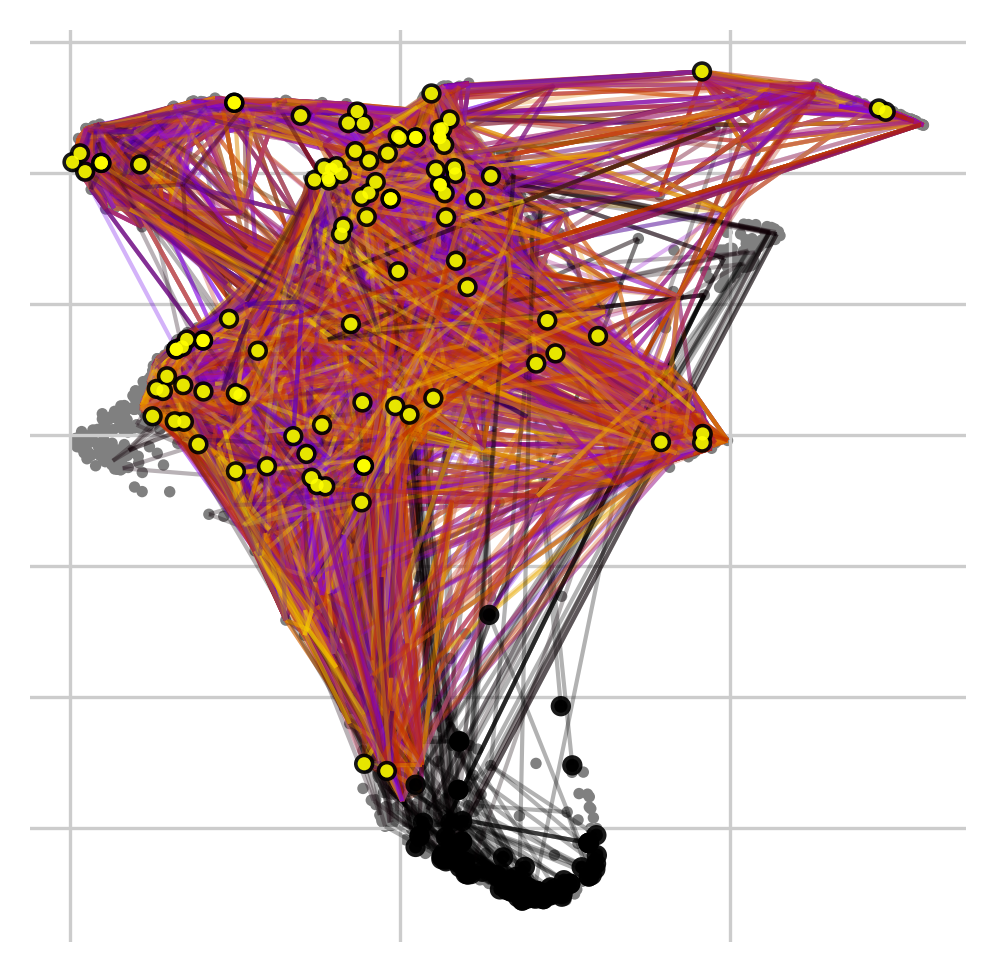

In [107]:
tmk.plot_random_walks(n_sims=100,
    max_iter=500,
    start_ixs={"time": 0},
    basis="X_phate",
    seed=0,
    dpi=150,
    size=30,
)

Projecting transition matrix onto `phate`
Adding `adata.obsm['T_fwd_phate']`
    Finish (0:00:00)


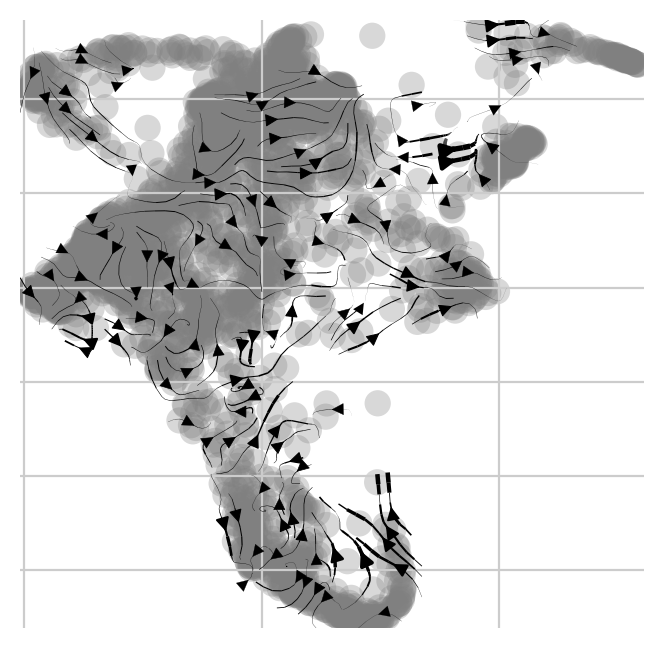

In [108]:
tmk.plot_projection(basis = 'X_phate', connectivities = tmk.transition_matrix,stream=True,recompute=False)

In [109]:
from cellrank.estimators import GPCCA

g = GPCCA(tmk)
print(g)

GPCCA[kernel=RealTimeKernel[n=2684], initial_states=None, terminal_states=None]


Computing Schur decomposition
Adding `adata.uns['eigendecomposition_fwd']`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:05)
Computing `12` macrostates
Adding `.macrostates`
       `.macrostates_memberships`
       `.coarse_T`
       `.coarse_initial_distribution
       `.coarse_stationary_distribution`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:13)


/home/chanj2/part2/lib/python3.11/site-packages/scvelo/plotting/scatter.py:656: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(
/home/chanj2/part2/lib/python3.11/site-packages/scvelo/plotting/scatter.py:694: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/chanj2/part2/lib/python3.11/site-packages/scvelo/plotting/utils.py:1396: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(x, y, s=bg_size, marker=".", c=bg_color, zorder=zord - 2, **kwargs)
/home/chanj2/part2/lib/python3.11/site-packages/scvelo/plotting/utils.py:1397: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(x, y, s=gp_size, marker=".", c=gp_color, zorder=zord - 1, **kwargs)


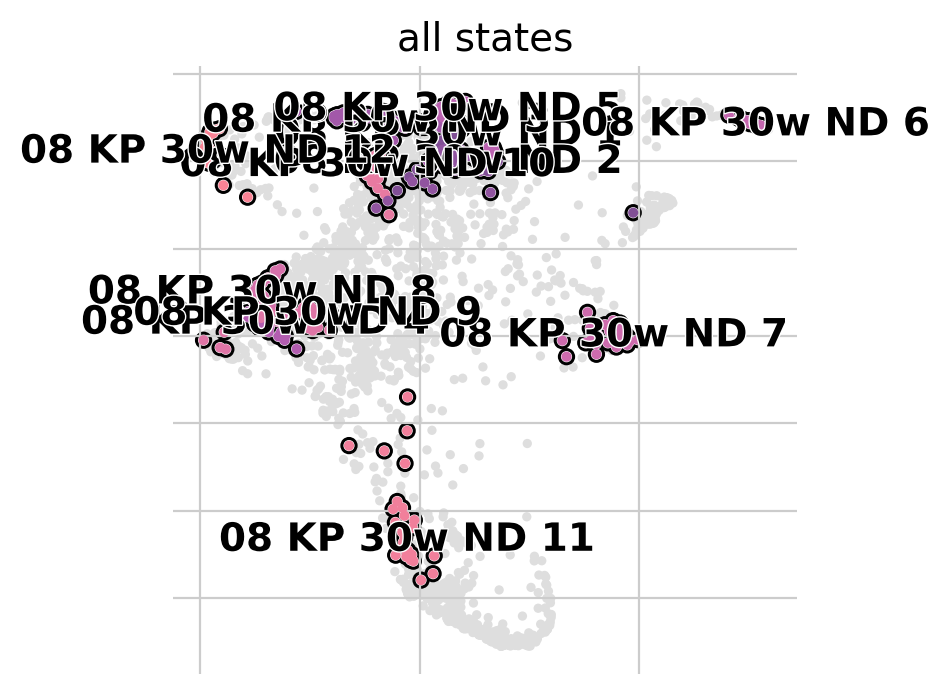

In [110]:
g.fit(n_states=12, cluster_key="timesimple")
g.plot_macrostates(which="all",basis="X_phate", )

Adding `adata.obs['term_states_fwd']`
       `adata.obs['term_states_fwd_probs']`
       `.terminal_states`
       `.terminal_states_probabilities`
       `.terminal_states_memberships
    Finish`


/home/chanj2/part2/lib/python3.11/site-packages/scvelo/plotting/scatter.py:656: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(
/home/chanj2/part2/lib/python3.11/site-packages/scvelo/plotting/scatter.py:694: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/chanj2/part2/lib/python3.11/site-packages/scvelo/plotting/utils.py:1396: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(x, y, s=bg_size, marker=".", c=bg_color, zorder=zord - 2, **kwargs)
/home/chanj2/part2/lib/python3.11/site-packages/scvelo/plotting/utils.py:1397: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(x, y, s=gp_size, marker=".", c=gp_color, zorder=zord - 1, **kwargs)


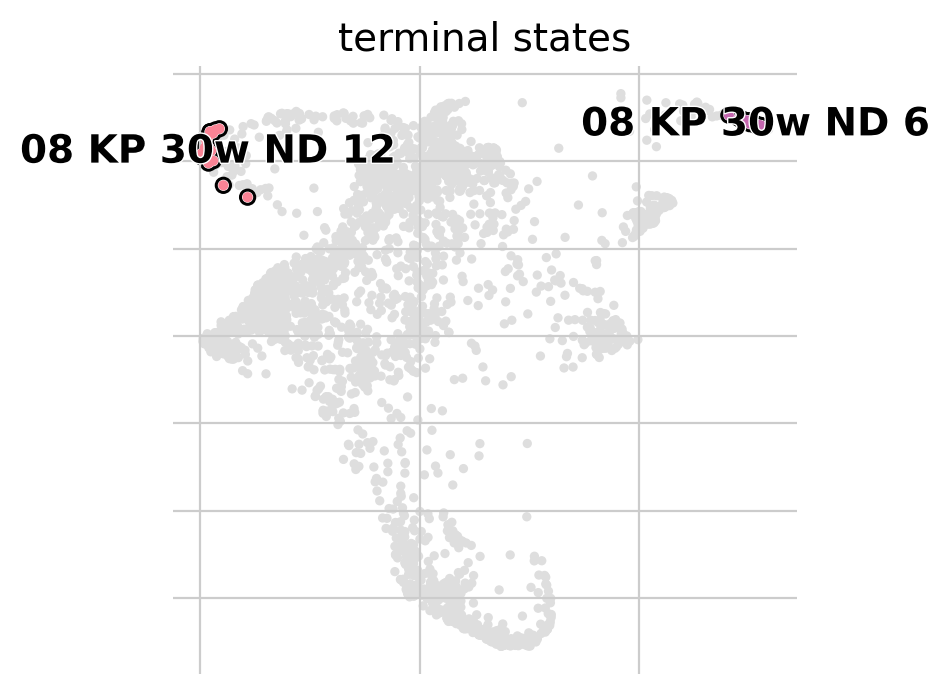

In [111]:
g.predict_terminal_states(method="top_n", n_states=2)
g.plot_macrostates(which="terminal",basis="X_phate",)

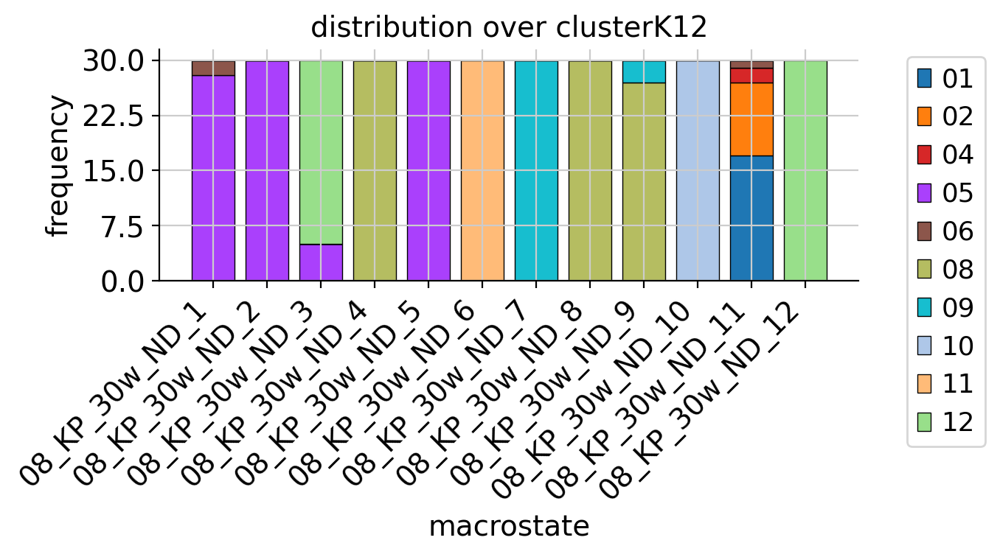

In [112]:
g.plot_macrostate_composition(key="clusterK12", figsize=(7, 4))

Computing fate probabilities
Defaulting to `'gmres'` solver.


100%|██████████| 2/2 [00:00<00:00, 15.97/s]


Adding `adata.obsm['lineages_fwd']`
       `.fate_probabilities`
    Finish (0:00:00)


/home/chanj2/part2/lib/python3.11/site-packages/scvelo/plotting/scatter.py:656: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(
/home/chanj2/part2/lib/python3.11/site-packages/scvelo/plotting/scatter.py:656: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(


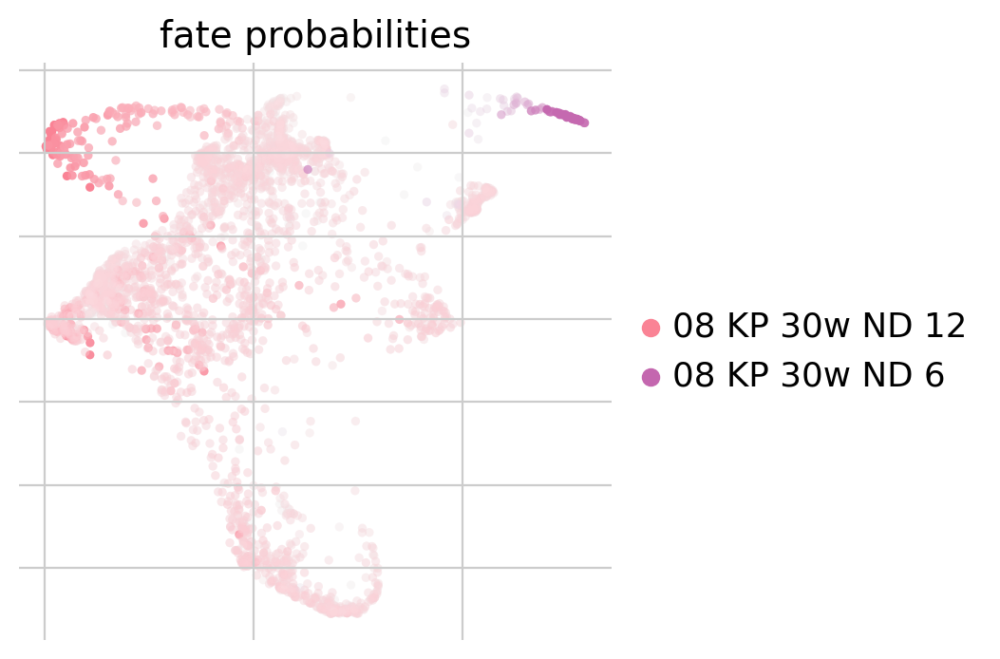

In [113]:
g.compute_fate_probabilities()
g.plot_fate_probabilities(legend_loc="right",basis="X_phate",)

In [114]:
drivers = g.compute_lineage_drivers(lineages="08_KP_30w_ND_12")
drivers.head(10)

Adding `adata.varm['terminal_lineage_drivers']`
       `.lineage_drivers`
    Finish (0:00:02)


,08_KP_30w_ND_12_corr,08_KP_30w_ND_12_pval,08_KP_30w_ND_12_qval,08_KP_30w_ND_12_ci_low,08_KP_30w_ND_12_ci_high
Atp1b1,0.436777,7.506255e-130,3.960136e-127,0.405646,0.466897
Wfdc2,0.435955,2.688986e-129,1.396825e-126,0.404797,0.466102
Npc2,0.433113,2.146007e-127,1.065587e-124,0.401863,0.463355
Sftpb,0.432014,1.152084e-126,5.557160e-124,0.400730,0.462293
Selenbp1,0.425703,1.574946e-122,7.186224e-120,0.394218,0.456191
Kng2,0.398995,4.603109e-106,1.746337e-103,0.366695,0.430333
Sfta2,0.390572,3.338421e-101,1.174185e-98,0.358027,0.422168
Hp,0.390258,5.031557e-101,1.751449e-98,0.357705,0.421864
Ager,0.387218,2.607888e-99,8.985239e-97,0.354578,0.418916
Mgst1,0.387127,2.934499e-99,9.961479e-97,0.354484,0.418827


In [115]:
model = cr.models.GAMR(adata)
#model = cr.models.GAMR(adata, n_knots=5, smoothing_penalty=10.0)

Computing trends using `1` core(s)


100%|██████████| 6/6 [00:00<00:00, 24.54gene/s]

    Finish (0:00:00)
Plotting trends


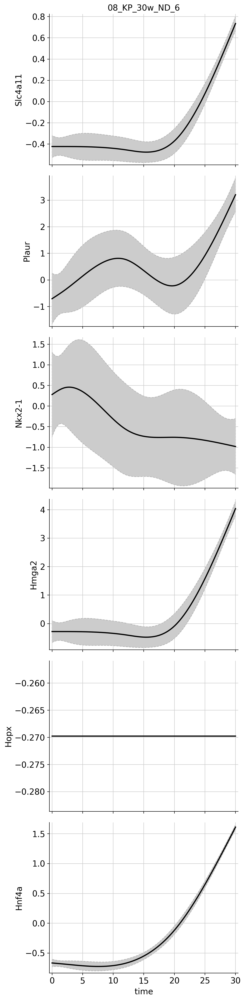

In [116]:
# try physical time, but it appears there is not enough granularity to pull out lineages
cr.pl.gene_trends(
    adata,
    model=model,
    genes=["Slc4a11", "Plaur", "Nkx2-1", "Hmga2",'Hopx','Hnf4a'],
    same_plot=False,
    ncols=2,
    #time_key="palantir_pseudotime",
    time_key="time",
    hide_cells=True,
)

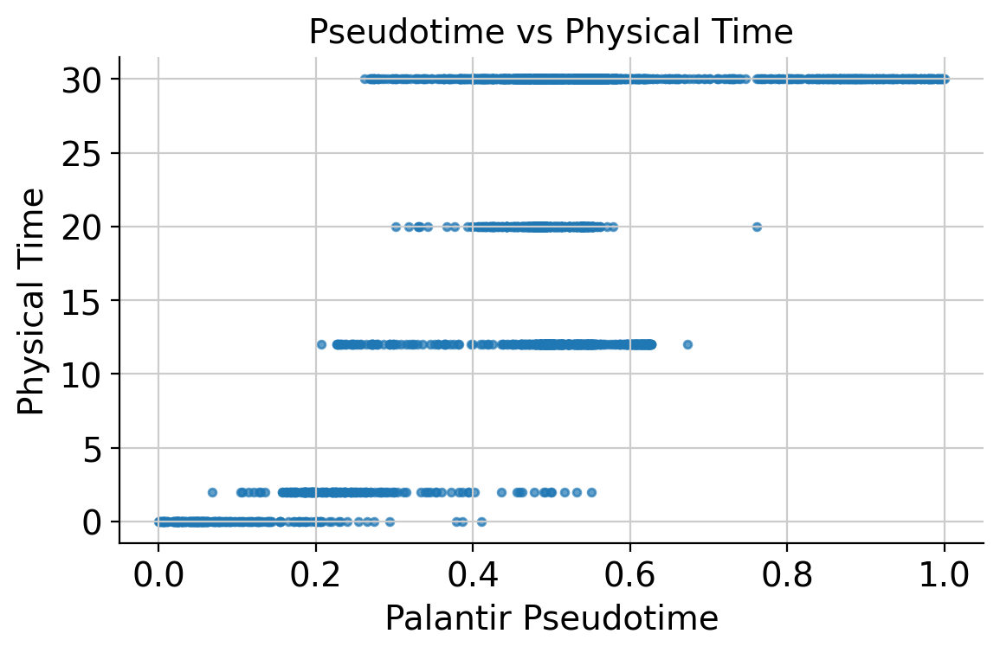

In [117]:
# Double check to see if palantir pseudotime is a reasonable input in lieu of physical time given physical time does not have enough granularity
pseudotime = adata.obs['palantir_pseudotime']
physical_time = adata.obs['time']

plt.figure(figsize=(6, 4))
plt.scatter(pseudotime, physical_time, s=10, alpha=0.7)
plt.xlabel('Palantir Pseudotime')
plt.ylabel('Physical Time')
plt.title('Pseudotime vs Physical Time')
plt.tight_layout()
plt.show()

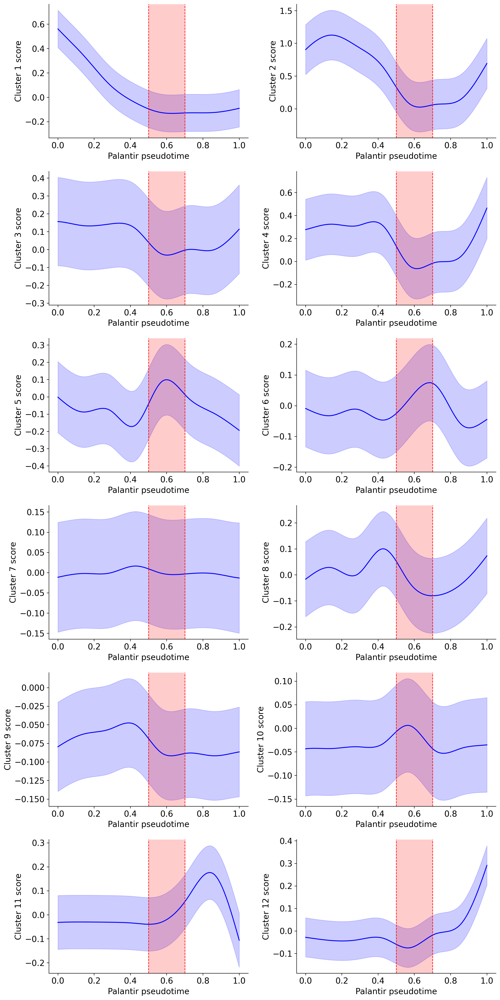

In [118]:
# Now use it to order the cells and use the cluster programs to define the HPCS (Cluster 5)

import seaborn as sns
from pygam import LinearGAM, s  # or use statsmodels.gam if preferred

fig,ax = plt.subplots(nrows=6,ncols=2, figsize=(12,24))
pseudotime = adata.obs['palantir_pseudotime'].values
#pseudotime = adata.obs['time'].values

for x in range(0,12):
    score = adata.obs['Cluster %d' % (x+1)].values
    gam = LinearGAM(s(0, n_splines=10)).fit(pseudotime.reshape(-1, 1), score)
    pseudotime_sorted = np.linspace(pseudotime.min(), pseudotime.max(), 500)
    #pseudotime_sorted = np.linspace(pseudotime.as_ordered().min(), pseudotime.as_ordered().max(), 500)
    score_pred = gam.predict(pseudotime_sorted)
    confidence_interval = gam.prediction_intervals(pseudotime_sorted, width=0.95)

    ax[int(x/2), x%2].plot(pseudotime_sorted, score_pred, color='blue', label='GAM fit', )
    #ax[int(x/2), x%2].set_xlim(xmin=0,xmax=1)
    ax[int(x/2), x%2].fill_between(pseudotime_sorted,
                 confidence_interval[:, 0],
                 confidence_interval[:, 1],
                 color='blue', alpha=0.2, label='95% CI')
    ax[int(x/2), x%2].set_xlabel('Palantir pseudotime')
    ax[int(x/2), x%2].set_ylabel('Cluster %d score' % (x+1))
    #ax[int(x/2), x%2].set_title('Cluster %d score vs Palantir pseudotime' % (x+1))
    #ax[int(x/2), x%2].legend()
    #ax[int(x/2), x%2].axhline(y=0, color='black', linestyle='--', linewidth=1)
    ax[int(x/2), x%2].axvline(x=0.50, color='red', linestyle='--', linewidth=1)
    ax[int(x/2), x%2].axvline(x=0.70, color='red', linestyle='--', linewidth=1)

    ax[int(x/2), x%2].axvspan(0.5, 0.7, facecolor='red', alpha=0.2)
    ax[int(x/2), x%2].grid(False)

    
#sns.scatterplot(x=pseudotime, y=score, alpha=0.3, label='Raw data')
# plt.plot(pseudotime_sorted, score_pred, color='blue', label='GAM fit')
# plt.fill_between(pseudotime_sorted,
#                  confidence_interval[:, 0],
#                  confidence_interval[:, 1],
#                  color='blue', alpha=0.2, label='95% CI')
# plt.xlabel('Palantir pseudotime')
# plt.ylabel('Cluster 5 gene set score')
# plt.title('Gene set trend over pseudotime')
#plt.legend()
#plt.savefig('figures/cluster_trends.svg')
plt.tight_layout()
plt.show()


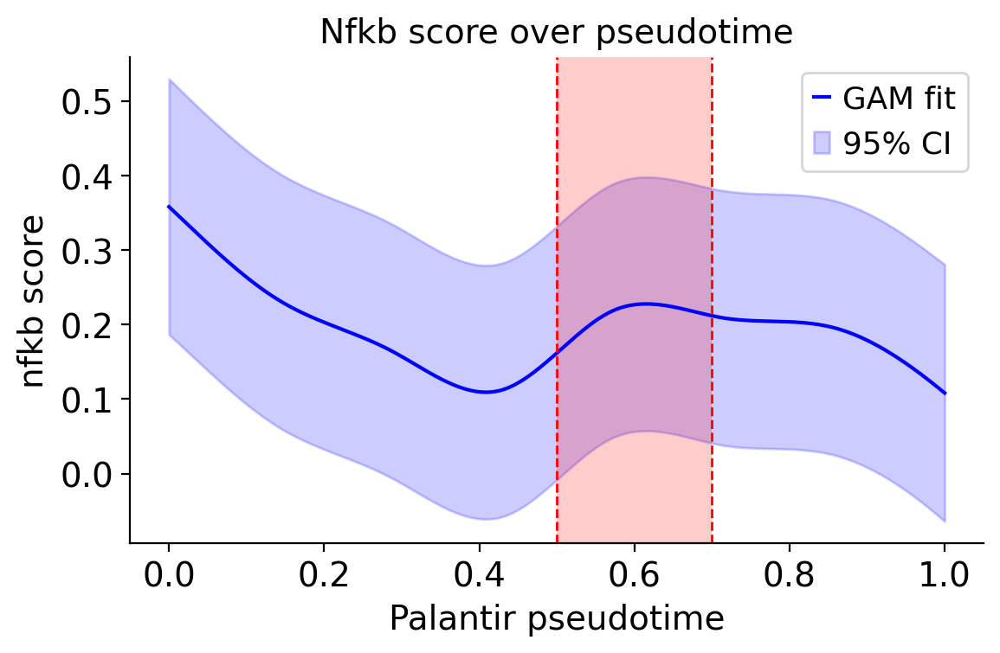

In [119]:
# Now use it to order the cells and plot Nfkb program

import seaborn as sns
from pygam import LinearGAM, s  # or use statsmodels.gam if preferred

fig,ax = plt.subplots(figsize=(6,4))
pseudotime = adata.obs['palantir_pseudotime'].values
#pseudotime = adata.obs['time'].values

score = adata.obs['nfkb'].values
gam = LinearGAM(s(0, n_splines=10)).fit(pseudotime.reshape(-1, 1), score)
pseudotime_sorted = np.linspace(pseudotime.min(), pseudotime.max(), 500)
#pseudotime_sorted = np.linspace(pseudotime.as_ordered().min(), pseudotime.as_ordered().max(), 500)
score_pred = gam.predict(pseudotime_sorted)
confidence_interval = gam.prediction_intervals(pseudotime_sorted, width=0.95)

ax.plot(pseudotime_sorted, score_pred, color='blue', label='GAM fit', )
#ax[int(x/2), x%2].set_xlim(xmin=0,xmax=1)
ax.fill_between(pseudotime_sorted,
             confidence_interval[:, 0],
             confidence_interval[:, 1],
             color='blue', alpha=0.2, label='95% CI')
ax.set_xlabel('Palantir pseudotime')
ax.set_ylabel('nfkb score')
#ax[int(x/2), x%2].set_title('Cluster %d score vs Palantir pseudotime' % (x+1))
#ax[int(x/2), x%2].legend()
#ax[int(x/2), x%2].axhline(y=0, color='black', linestyle='--', linewidth=1)
ax.axvline(x=0.50, color='red', linestyle='--', linewidth=1)
ax.axvline(x=0.70, color='red', linestyle='--', linewidth=1)

ax.axvspan(0.5, 0.7, facecolor='red', alpha=0.2)
ax.grid(False)

    
#sns.scatterplot(x=pseudotime, y=score, alpha=0.3, label='Raw data')
# plt.plot(pseudotime_sorted, score_pred, color='blue', label='GAM fit')
# plt.fill_between(pseudotime_sorted,
#                  confidence_interval[:, 0],
#                  confidence_interval[:, 1],
#                  color='blue', alpha=0.2, label='95% CI')
# plt.xlabel('Palantir pseudotime')
# plt.ylabel('Cluster 5 gene set score')
plt.title('Nfkb score over pseudotime')
plt.legend()
plt.savefig('figures/ExtData_Fig5_nfkb_trend.svg')
plt.tight_layout()
plt.show()


Computing trends using `1` core(s)


100%|██████████| 7/7 [00:00<00:00, 15.90gene/s]

    Finish (0:00:00)
Plotting trends



/home/chanj2/part2/lib/python3.11/site-packages/cellrank/models/_base_model.py:798: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  _ = ax.scatter(
/home/chanj2/part2/lib/python3.11/site-packages/cellrank/models/_base_model.py:798: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  _ = ax.scatter(
/home/chanj2/part2/lib/python3.11/site-packages/cellrank/models/_base_model.py:798: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  _ = ax.scatter(
/home/chanj2/part2/lib/python3.11/site-packages/cellrank/models/_base_model.py:798: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  _ = ax.scatter(
/home/chanj2/part2/lib/python3.11/site-packages/cellrank/models/_base_model.py:798: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  _ = ax.scatter(
/home/chanj2/part2/lib/python3.11/site-

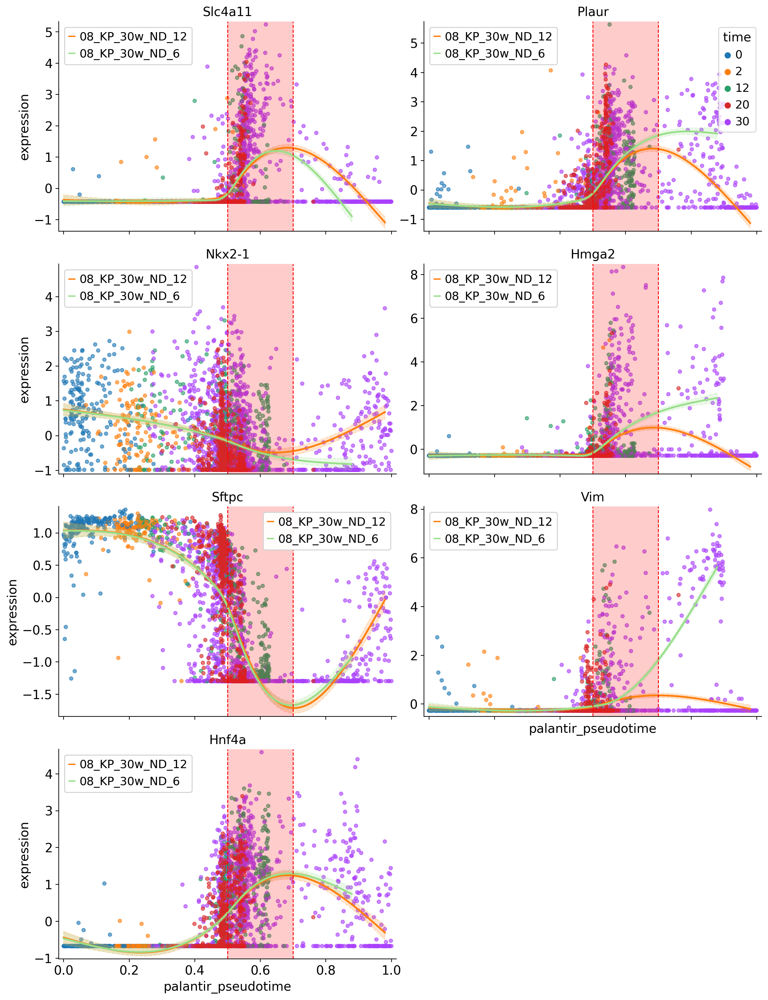

In [120]:
# Now use that time interval and plot it with gene trends, showing cells' physical time as a sanity check

fig = cr.pl.gene_trends(
    adata,
    model=model,
    genes=["Slc4a11", "Plaur", "Nkx2-1", "Hmga2",'Sftpc','Vim','Hnf4a'],
    same_plot=True,
    ncols=2,
    time_key="palantir_pseudotime",
    #time_key="time",
    #lineage_cmap=['Green','Blue'],
    lineage_cmap=['#ff7f0e','#98df8a'], #consistent with paper uMAP but bad contrast with 
    hide_cells=False,
    return_figure=True,
    cell_color="time",
    obs_legend_loc = "top"
)

# Get axes from the figure and add vertical line at x=0.45
for ax in fig.get_axes():
    ax.axvline(x=0.5, color='red', linestyle='--', linewidth=1)
    ax.axvline(x=0.7, color='red', linestyle='--', linewidth=1)

    ax.axvspan(0.5, 0.7, facecolor='red', alpha=0.2)
    ax.grid(False)

# Show the modified plot
#plt.savefig('figures/Ext_Data_Fig6b_lineagetrends.svg')
plt.show()

Computing trends using `1` core(s)


100%|██████████| 3/3 [00:00<00:00, 13.31gene/s]

    Finish (0:00:00)
Plotting trends


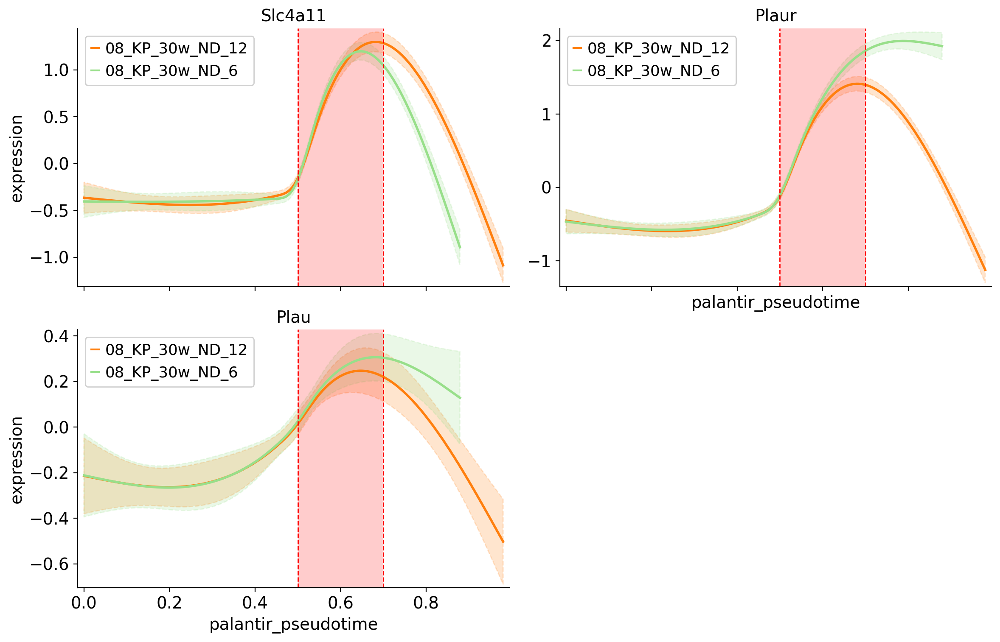

In [121]:
# Now plot a nice image for the paper

fig = cr.pl.gene_trends(
    adata,
    model=model,
    genes=["Slc4a11", "Plaur", "Plau"], #, "Hmga2",'Sftpc','Vim','Hnf4a', 'Plau','Plat'],
    same_plot=True,
    ncols=2,
    time_key="palantir_pseudotime",
    #time_key="time",
    #lineage_cmap=['Green','Blue'],
    lineage_cmap=['#ff7f0e','#98df8a'], #consistent with paper uMAP but bad contrast with 
    hide_cells=True,
    return_figure=True
)

# Get axes from the figure and add vertical line at x=0.45
for ax in fig.get_axes():
    ax.axvline(x=0.5, color='red', linestyle='--', linewidth=1)
    ax.axvline(x=0.7, color='red', linestyle='--', linewidth=1)

    ax.axvspan(0.5, 0.7, facecolor='red', alpha=0.2)
    ax.grid(False)

# Show the modified plot
plt.savefig('figures/ExtData_Fig5_lineagetrends.svg')
plt.show()

Computing trends using `1` core(s)


100%|██████████| 4/4 [00:00<00:00, 14.42gene/s]

    Finish (0:00:00)
Plotting trends


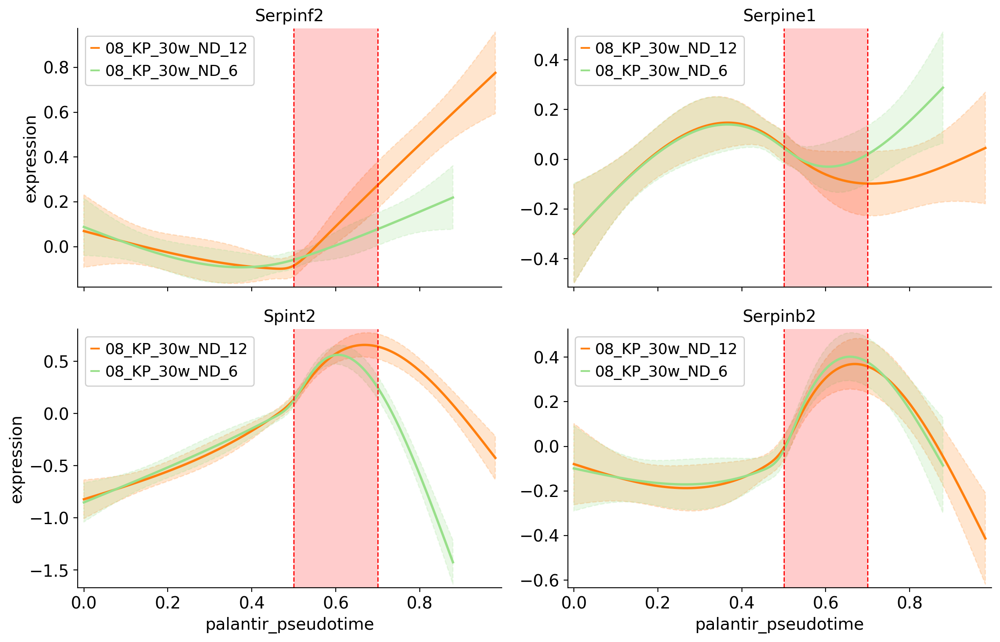

In [122]:
# Now plot a nice image for the paper

fig = cr.pl.gene_trends(
    adata,
    model=model,
    genes=['Serpinf2', 'Serpine1', 'Spint2','Serpinb2'], #'Tbpl1',
    same_plot=True,
    ncols=2,
    time_key="palantir_pseudotime",
    #time_key="time",
    #lineage_cmap=['Green','Blue'],
    lineage_cmap=['#ff7f0e','#98df8a'], #consistent with paper uMAP but bad contrast with 
    hide_cells=True,
    return_figure=True
)

# Get axes from the figure and add vertical line at x=0.45
for ax in fig.get_axes():
    ax.axvline(x=0.5, color='red', linestyle='--', linewidth=1)
    ax.axvline(x=0.7, color='red', linestyle='--', linewidth=1)

    ax.axvspan(0.5, 0.7, facecolor='red', alpha=0.2)
    ax.grid(False)

# Show the modified plot
#plt.savefig('figures/lineagetrends2.svg')
plt.show()

Computing trends using `1` core(s)


100%|██████████| 6/6 [00:00<00:00, 15.94gene/s]

    Finish (0:00:00)


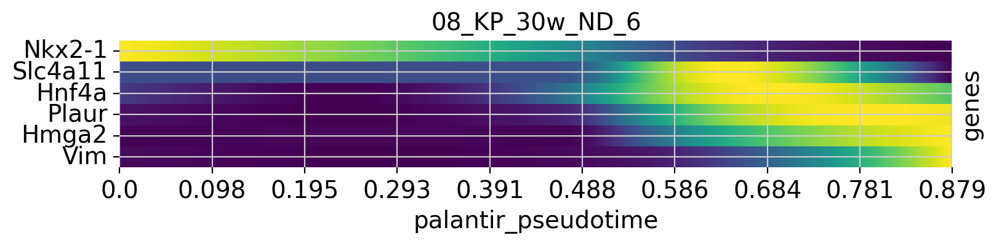

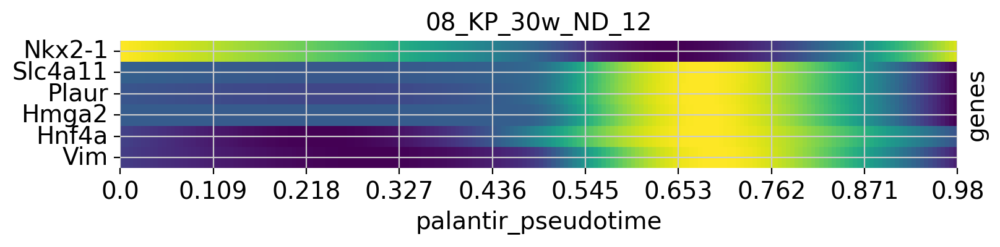

In [123]:
cr.pl.heatmap(
    adata,
    model=model,
    #data_key="MAGIC_imputed_data",
    genes=["Slc4a11", "Plaur", "Nkx2-1", "Hmga2",'Vim','Hnf4a'],
    lineages=["08_KP_30w_ND_6", "08_KP_30w_ND_12"],
    time_key="palantir_pseudotime",
    cbar=False,
    show_all_genes=True,
)

In [124]:
old_colors = adata.uns['clusterK12_colors'].copy()
adata.uns['clusterK12_colors'] = np.array(['#1f77b4', '#ff7f0e', '#279e68', '#d62728', '#d62728', '#8c564b',
       '#e377c2', '#b5bd61', '#17becf', '#aec7e8', '#98df8a','#ff7f0e',])
#adata.uns['clusterK12_colors'] = old_colors

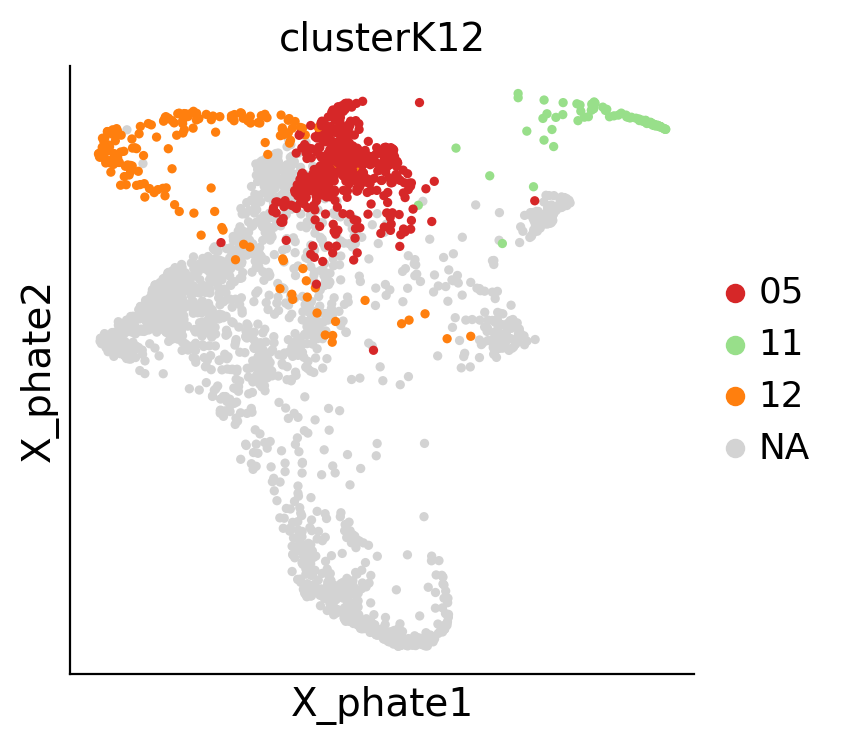

In [125]:
sc.pl.embedding(adata, color=['clusterK12'],groups=['05','11','12'], basis='X_phate', save='ExtData_Fig5_endpoints_w5.svg')